# CIS 5450 Final Project - Cardiovascular Disease Risk Prediction

**Authors:** Felix Yuzhou Sun, Ganlin Ouyang, Qi Yu

## Part 1: Introduction


In our final project, we have focused on developing machine learning-based predictive models to evaluate the risks associated with cardiovascular diseases (CVDs) and other health factors. We utilized the 2021 Behavioral Risk Factor Surveillance System (BRFSS) dataset, provided by the Centers for Disease Control and Prevention (CDC), with the aim of identifying crucial patterns and risk factors pertinent to cardiovascular health.

The BRFSS is a leading health-related telephone survey in the United States, collecting comprehensive data on residents' health behaviors, chronic conditions, and preventive service usage.

Our selected dataset comprises 19 carefully chosen variables, focusing on lifestyle factors that could potentially influence the risk of CVDs. These variables encompass a range of aspects from dietary habits to medical history, offering a broad perspective on factors affecting cardiovascular health.
(Dataset Source: https://www.kaggle.com/datasets/alphiree/cardiovascular-diseases-risk-prediction-dataset)

Our methodology encompasses thorough data preprocessing, exploratory data analysis, feature engineering, and rigorous evaluation of machine learning models to ensure the predictions are both accurate and reliable."

This project aims not only to enhance understanding of cardiovascular risk factors but also to provide a data-driven insights for predicting and managing health risks associated with CVDs.



## Part 2: Data Loading & Preprocessing


First and foremost, import the relevant libraries for all stages of our project.

In [ ]:
!pip install imbalanced-learn
# import packages
import json
import glob
import pandas as pd
import numpy as np
import datetime as dt
import re
import os
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import cm
from google.colab import drive
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, auc, confusion_matrix, classification_report, precision_score, recall_score, f1_score, make_scorer
from collections import Counter
import seaborn as sns
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder, StandardScaler, label_binarize
import warnings
from sklearn.cluster import KMeans
from sklearn.linear_model import LogisticRegression
warnings.filterwarnings("ignore", category=DeprecationWarning)
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from itertools import cycle
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import plotly.express as px

### 2.1 Read and Load Data
For this project, we are using one CSV, CVD_cleaned.csv from a kaggle [dataset](https://www.kaggle.com/datasets/alphiree/cardiovascular-diseases-risk-prediction-dataset
). The dataset contains 19 columns and over 300k property entries.

We will download the dataset by calling the kaggle API.

In [ ]:
%%capture
!apt update
!pip install kaggle

In [ ]:
# mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Create the kaggle directory and
# (NOTE: Do NOT run this cell more than once unless restarting kernel)
!mkdir ~/.kaggle

In [ ]:
# Read the uploaded kaggle.json file
!cp /content/drive/MyDrive/kaggle.json ~/.kaggle/

In [ ]:
# Download the data set
!!kaggle datasets download -d alphiree/cardiovascular-diseases-risk-prediction-dataset

['Downloading cardiovascular-diseases-risk-prediction-dataset.zip to /content',
 '',
 '  0% 0.00/4.87M [00:00<?, ?B/s]',
 '',
 '100% 4.87M/4.87M [00:00<00:00, 191MB/s]']

In [ ]:
# Unzip folder in Colab content folder
!unzip /content/cardiovascular-diseases-risk-prediction-dataset.zip

Archive:  /content/cardiovascular-diseases-risk-prediction-dataset.zip
  inflating: CVD_cleaned.csv         


In [ ]:
# Read the csv file and save it to a dataframe called "raw_data"
raw_data = pd.read_csv('CVD_cleaned.csv')

# Check out the first five rows
raw_data.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150.0,32.66,14.54,Yes,0.0,30.0,16.0,12.0
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165.0,77.11,28.29,No,0.0,30.0,0.0,4.0
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163.0,88.45,33.47,No,4.0,12.0,3.0,16.0
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180.0,93.44,28.73,No,0.0,30.0,30.0,8.0
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191.0,88.45,24.37,Yes,0.0,8.0,4.0,0.0


#### 2.1.2 Analyzing Data Structure


To get a better sense of the data structure, we will first exam the data types of the dataset.

In [ ]:
# display the datatypes and filled entries in `df_properties`
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 308854 entries, 0 to 308853
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   General_Health                308854 non-null  object 
 1   Checkup                       308854 non-null  object 
 2   Exercise                      308854 non-null  object 
 3   Heart_Disease                 308854 non-null  object 
 4   Skin_Cancer                   308854 non-null  object 
 5   Other_Cancer                  308854 non-null  object 
 6   Depression                    308854 non-null  object 
 7   Diabetes                      308854 non-null  object 
 8   Arthritis                     308854 non-null  object 
 9   Sex                           308854 non-null  object 
 10  Age_Category                  308854 non-null  object 
 11  Height_(cm)                   308854 non-null  float64
 12  Weight_(kg)                   308854 non-nul

From above, we can conclude that:
1.   **No missing values:**
All variables have a non-null count of 308,854, indicating a complete dataset
with no missing values.

2.   **Numeric and Categorical Variables:**
The dataset contains a mix of numeric (float64) and categorical (object) variables.
*   There are 7 numeric variables (Height_(cm), Weight_(kg), BMI,
Alcohol_Consumption, Fruit_Consumption, Green_Vegetables_Consumption, FriedPotato_Consumption).
*   There are 12 categorical variables (General_Health, Checkup, Exercise, Heart_Disease, Skin_Cancer, Other_Cancer, Depression, Diabetes, Arthritis, Sex, Age_Category, Smoking_History).






#### 2.1.3 Understanding the Data


In [ ]:
# Show the discriptive statistics
raw_data.describe()

,Height_(cm),Weight_(kg),BMI,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
count,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000
mean,170.615249,83.588655,28.626211,5.096366,29.835200,15.110441,6.296616
std,10.658026,21.343210,6.522323,8.199763,24.875735,14.926238,8.582954
min,91.000000,24.950000,12.020000,0.000000,0.000000,0.000000,0.000000
25%,163.000000,68.040000,24.210000,0.000000,12.000000,4.000000,2.000000
50%,170.000000,81.650000,27.440000,1.000000,30.000000,12.000000,4.000000
75%,178.000000,95.250000,31.850000,6.000000,30.000000,20.000000,8.000000
max,241.000000,293.020000,99.330000,30.000000,120.000000,128.000000,128.000000


The descriptive statistics contains only the numeric variables.


1. **Height (cm):**
The average height is about 170.62 cm with a standard deviation of 10.66 cm.
The range of height is quite broad (from 91 cm to 241 cm), suggesting a diverse dataset in terms of the physical stature of individuals.

2. **Weight (kg):**
The average weight is approximately 83.59 kg, with a standard deviation of 21.34 kg.
The maximum weight recorded is significantly high at 293.02 kg, indicating the presence of outliers or extreme values in the dataset.

3. **BMI (Body Mass Index):**
The mean BMI is 28.63, which is in the overweight range according to standard BMI classifications.
The range of BMI (12.02 to 99.33) includes underweight to extremely obese individuals, highlighting a wide variety of body types.

4. **Alcohol Consumption:**
The average alcohol consumption is 5.1 units, with a relatively high standard deviation of 8.2, indicating a varied drinking pattern among the individuals.
The maximum alcohol consumption is 30 units, suggesting some individuals have very high alcohol intake.

5. **Fruit Consumption:**
The mean fruit consumption is 29.84 units with a large standard deviation (24.88), showing significant variability in fruit consumption habits.
Some individuals consume up to 120 units of fruit, which is unusually high and might indicate data entry errors or outliers.

6. **Green Vegetables Consumption:**
The average consumption is 15.11 units with a considerable variation (standard deviation of 14.93).
The maximum value of 128 units again points towards possible outliers or data entry errors.

7. **Fried Potato Consumption:**
Average consumption is 6.3 units, but the standard deviation is high (8.58), suggesting diverse eating habits in terms of fried potato intake.
The presence of high maximum values (128 units) indicates outliers or exceptional cases in the dataset.

**Overall Implications:**

* The dataset reflects a wide range of lifestyles and physical characteristics
among the individuals.
* The presence of extreme values or high standard deviations in several variables suggests variability and the possibility of outliers in the dataset.
The BMI data indicates a tendency towards overweight and obesity in the population being studied.
* Dietary habits, as seen in the fruit and vegetable consumption data, vary significantly among individuals, indicating diverse eating patterns.
* The data on alcohol and fried potato consumption points to diverse habits in terms of potentially unhealthy lifestyle choices.


To better understand the dataset, especial the categorical  data that are not shown in the descriptive statistics, we will exam the first 10 rows of the data.

In [ ]:
raw_data.head(10)

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150.0,32.66,14.54,Yes,0.0,30.0,16.0,12.0
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165.0,77.11,28.29,No,0.0,30.0,0.0,4.0
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163.0,88.45,33.47,No,4.0,12.0,3.0,16.0
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180.0,93.44,28.73,No,0.0,30.0,30.0,8.0
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191.0,88.45,24.37,Yes,0.0,8.0,4.0,0.0
5,Good,Within the past year,No,No,No,No,Yes,No,Yes,Male,60-64,183.0,154.22,46.11,No,0.0,12.0,12.0,12.0
6,Fair,Within the past year,Yes,Yes,No,No,No,No,Yes,Male,60-64,175.0,69.85,22.74,Yes,0.0,16.0,8.0,0.0
7,Good,Within the past year,Yes,No,No,No,No,No,Yes,Female,65-69,165.0,108.86,39.94,Yes,3.0,30.0,8.0,8.0
8,Fair,Within the past year,No,No,No,No,Yes,No,No,Female,65-69,163.0,72.57,27.46,Yes,0.0,12.0,12.0,4.0
9,Fair,Within the past year,No,No,No,No,No,Yes,Yes,Female,70-74,163.0,91.63,34.67,No,0.0,12.0,12.0,1.0


We can see that:

1. 'Gerneral_Health', 'Checkup', and 'Age_Category' are categorical features with more than 3 unique values.

2. 'Exercise', 'Heart_Diseas', 'Skin_Cancer', 'Other_Cancer', 'Depression', 'Diabetes' 'Arthritis', 'Sex' and 'Smoking_History' may be binary variables.

We will exam the unique values of each categorical feature.

In [ ]:
raw_data['Checkup'].unique()

array(['Within the past 2 years', 'Within the past year',
       '5 or more years ago', 'Within the past 5 years', 'Never'],
      dtype=object)

In [ ]:
raw_data['General_Health'].unique()

array(['Poor', 'Very Good', 'Good', 'Fair', 'Excellent'], dtype=object)

In [ ]:
raw_data['Age_Category'].unique()

array(['70-74', '60-64', '75-79', '80+', '65-69', '50-54', '45-49',
       '18-24', '30-34', '55-59', '35-39', '40-44', '25-29'], dtype=object)

In [ ]:
selected_columns = ['Exercise',
                    'Heart_Disease',
                    'Skin_Cancer',
                    'Other_Cancer',
                    'Depression',
                    'Diabetes',
                    'Arthritis',
                    'Sex',
                    'Smoking_History']

for column in raw_data[selected_columns].columns:
    print(f"Value counts for {column}:")
    print(raw_data[column].unique())
    print("\n")  # Adds a new line for better readability

Value counts for Exercise:
['No' 'Yes']


Value counts for Heart_Disease:
['No' 'Yes']


Value counts for Skin_Cancer:
['No' 'Yes']


Value counts for Other_Cancer:
['No' 'Yes']


Value counts for Depression:
['No' 'Yes']


Value counts for Diabetes:
['No' 'Yes' 'No, pre-diabetes or borderline diabetes'
 'Yes, but female told only during pregnancy']


Value counts for Arthritis:
['Yes' 'No']


Value counts for Sex:
['Female' 'Male']


Value counts for Smoking_History:
['Yes' 'No']




After examining the unique values, we realized that 'Diabetes' has a more complex set of responses that not only capture binary outcomes but also account for conditions like pre-diabetes and gestational diabetes.

## Part 3: Exploratory Data Analysis

For the Exploratory Data Analysis (EDA) of our project on cardiovascular disease risk prediction using lifestyle factors, we will adopt a structured approach to understand the dataset's characteristics, uncover patterns, and prepare for subsequent modeling.

###3.1 Examing numeric valiables


####3.1.1 Check Distribution
Firstly, we check the distribution of these numeric variables with Histograms.


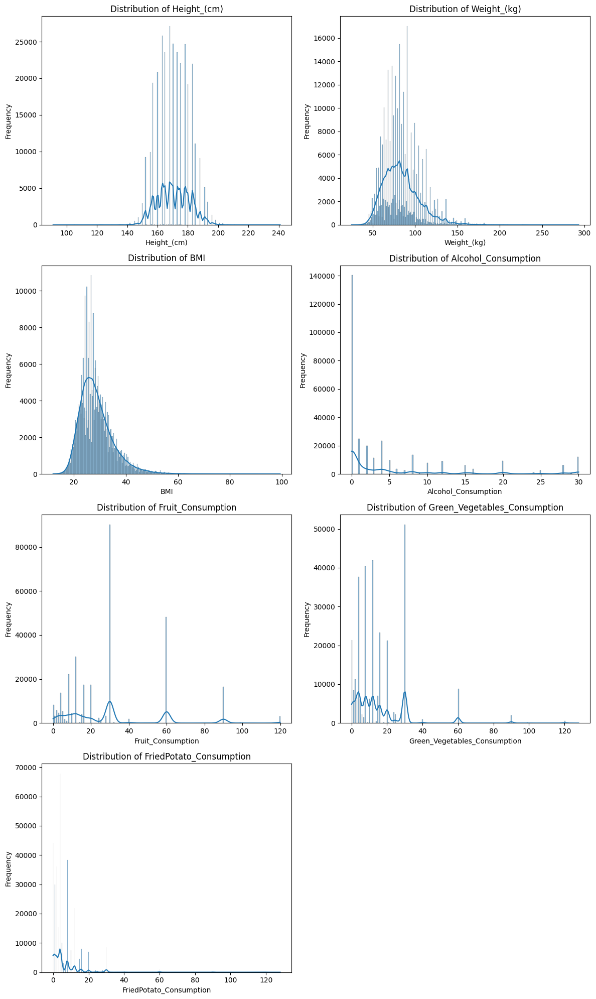

In [ ]:
numeric_columns = ['Height_(cm)', 'Weight_(kg)', 'BMI', 'Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']

# Determine the number of rows needed for subplots
num_rows = len(numeric_columns) // 2 + len(numeric_columns) % 2

# Create subplots
fig, axes = plt.subplots(num_rows, 2, figsize=(12, num_rows * 5))
axes = axes.flatten()  # Flatten the axes array

for i, col in enumerate(numeric_columns):
    sns.histplot(raw_data[col], kde=True, ax=axes[i])  # KDE adds a density line
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')

# Hide the last subplot if the number of plots is odd
if len(numeric_columns) % 2 != 0:
    axes[-1].axis('off')

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

The height featrue is normally distributed. The weight feature follows a bell shape, but is right skewed due to outliers. Similarly, the BMI feature follows a bell shape, but is right skewed due to outliers.

####3.1.2 Check Outliers

Then, we plot boxplots to check out the outliers and understanding the spread of the data.

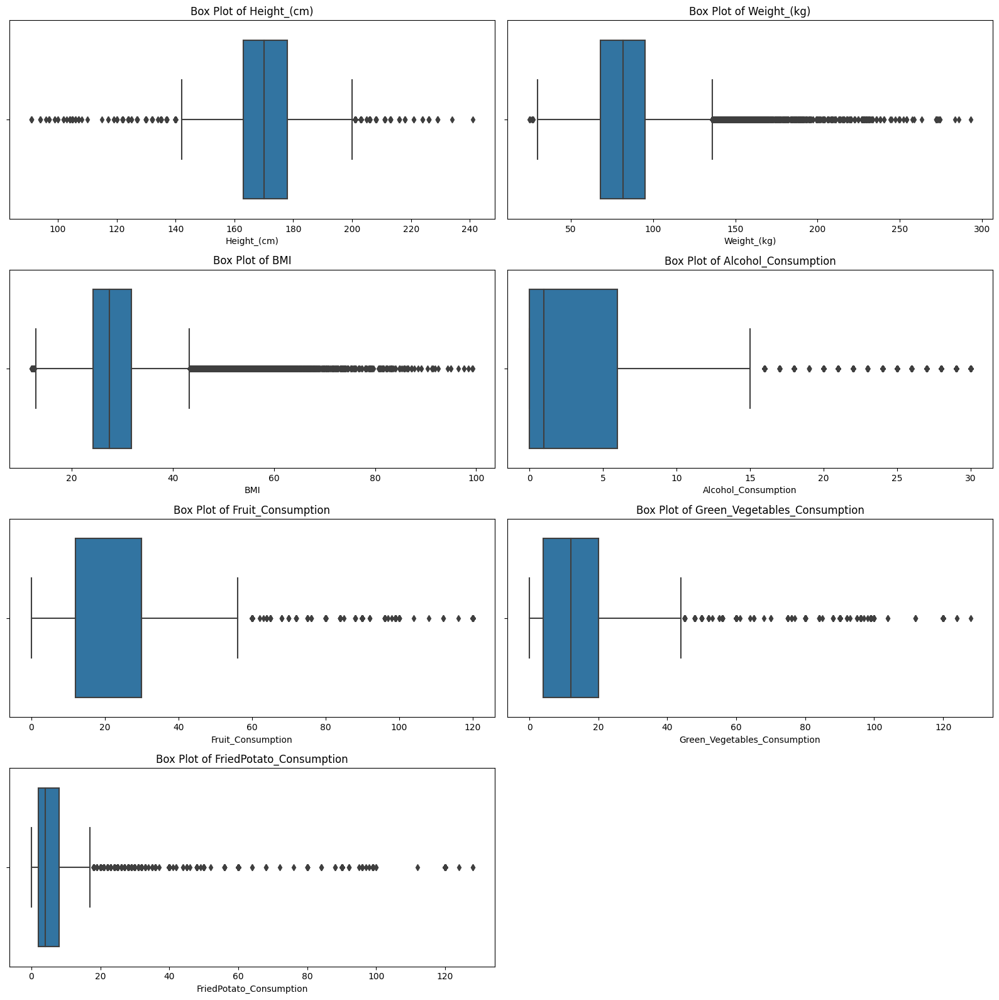

In [ ]:
# Create subplots for the boxplots
num_rows = len(numeric_columns) // 2 + len(numeric_columns) % 2
fig, axes = plt.subplots(num_rows, 2, figsize=(16, num_rows * 4))
axes = axes.flatten()  # Flatten the axes array

for i, col in enumerate(numeric_columns):
    sns.boxplot(x=raw_data[col], ax=axes[i])
    axes[i].set_title(f'Box Plot of {col}')
    axes[i].set_xlabel(col)

# Hide the last subplot if the number of plots is odd
if len(numeric_columns) % 2 != 0:
    axes[-1].axis('off')

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

Height (cm): The Height feature has a balanced number of small ourliers below 140cm and large outliers above 200cm. Given the youngest age category is 18-24, the extramely low outliers could be due to entry errors.

Weight (kg): The Weight feature has a large number of large ourliers.

BMI (Body Mass Index): The BMI feature, with weight feature as the numerator, also has a large number of large ourliers.

Alcohol Consumption: The Alcohol feature has a few large ourliers, possibly indicating addictions or data entry errors.

Fruit Consumption: The Fruit feature has a large number of large ourliers, which are extremely unlikly that a person consume more than 60 fruits per day. So they could be due to data entry errors.

Green Vegetables Consumption: The Green Vegetables Consumption feature has a large number of large ourliers. They could be due to data entry errors.

Fried Potato Consumption: The Fried Potato Consumption feature has a large number of large ourliers. They could be due to data entry errors.

###3.2 Examing the Categorical Features

####3.2.1 Examing Distribution

We will fisrt exam the distribution of value for each categorical feature.

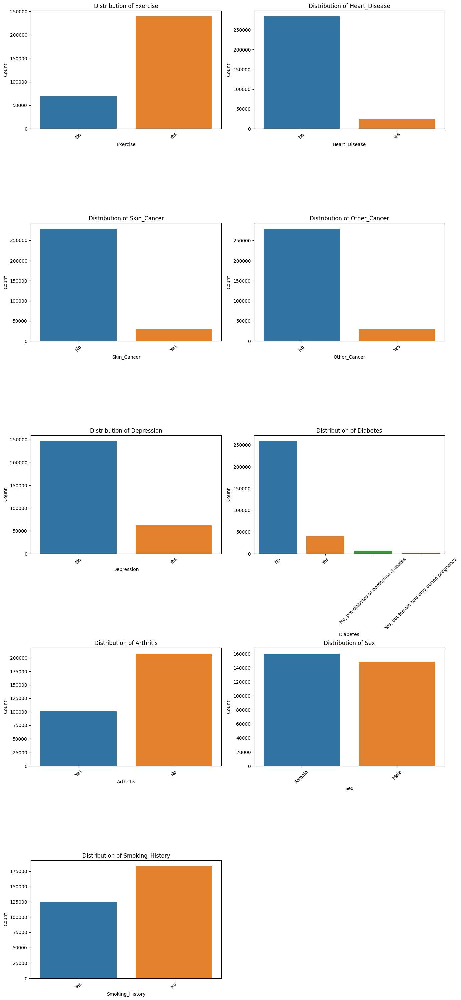

In [ ]:
selected_columns = [
    'Exercise',
    'Heart_Disease',
    'Skin_Cancer',
    'Other_Cancer',
    'Depression',
    'Diabetes',
    'Arthritis',
    'Sex',
    'Smoking_History'
]
num_rows = len(selected_columns) // 2 + len(selected_columns) % 2

# Create subplots
fig, axes = plt.subplots(num_rows, 2, figsize=(14, num_rows * 6))

# Flatten the axes array and plot bar charts for each column
axes = axes.flatten()
for i, col in enumerate(selected_columns):
    sns.countplot(x=col, data=raw_data, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=45)

# Hide unused subplots if the number of columns is odd
if len(selected_columns) % 2 != 0:
    fig.delaxes(axes[-1])  # Properly delete the last axis if not needed

# Adjust the layout to avoid tight layout issues
plt.tight_layout()
plt.subplots_adjust(hspace=0.8)  # Adjust vertical space between subplots
plt.show()

From the plot, we can see that the dataset contains highly imbalanced classes across those categorical features.This level of class imbalance can lead to biased model performance, where the predictive model might overly favor the majority class. It's crucial to address this imbalance using techniques such as resampling methods in the later steps.

####3.2.2 General Health

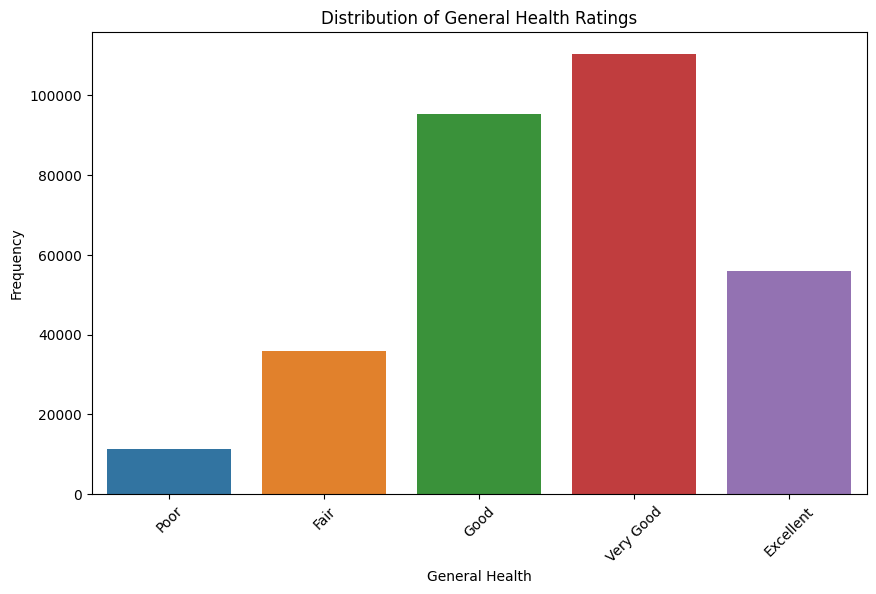

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='General_Health', data=raw_data,
              order=['Poor', 'Fair', 'Good', 'Very Good', 'Excellent'])
plt.title('Distribution of General Health Ratings')
plt.xlabel('General Health')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

For the distribution of general health, most of the self-rated general health conditions center around very good and good, with a small portion being fair and poor.

####3.2.3 Checkup

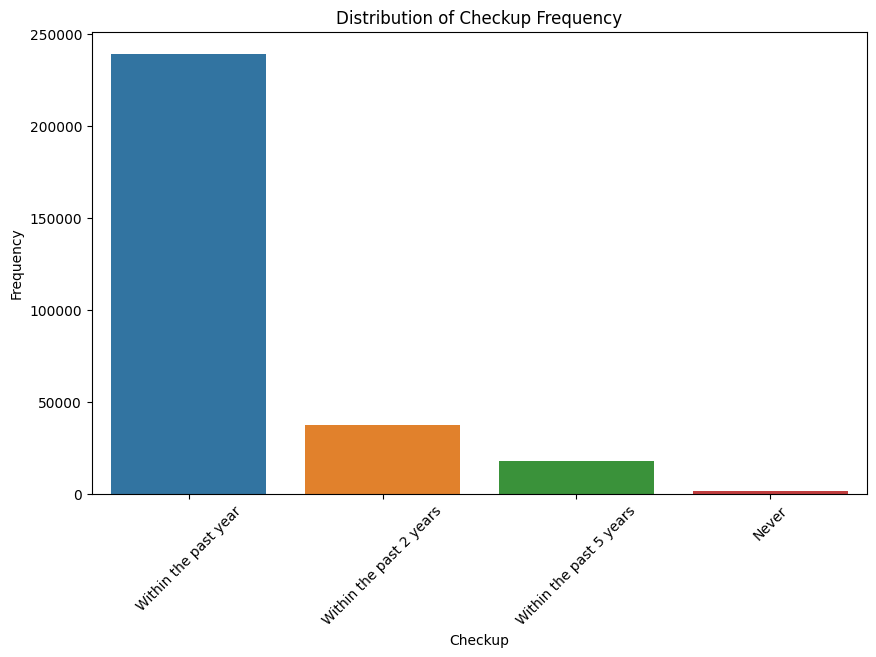

In [ ]:
checkup_order = ['Within the past year', 'Within the past 2 years', 'Within the past 5 years', 'Never']

# Create a count plot for the 'Checkup' column
plt.figure(figsize=(10, 6))
sns.countplot(x='Checkup', data=raw_data, order=checkup_order)
plt.title('Distribution of Checkup Frequency')
plt.xlabel('Checkup')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

For the distribution of checkup frequency, most of the subjects performed checkup within the past year.

#### 3.2.4 Age_Category

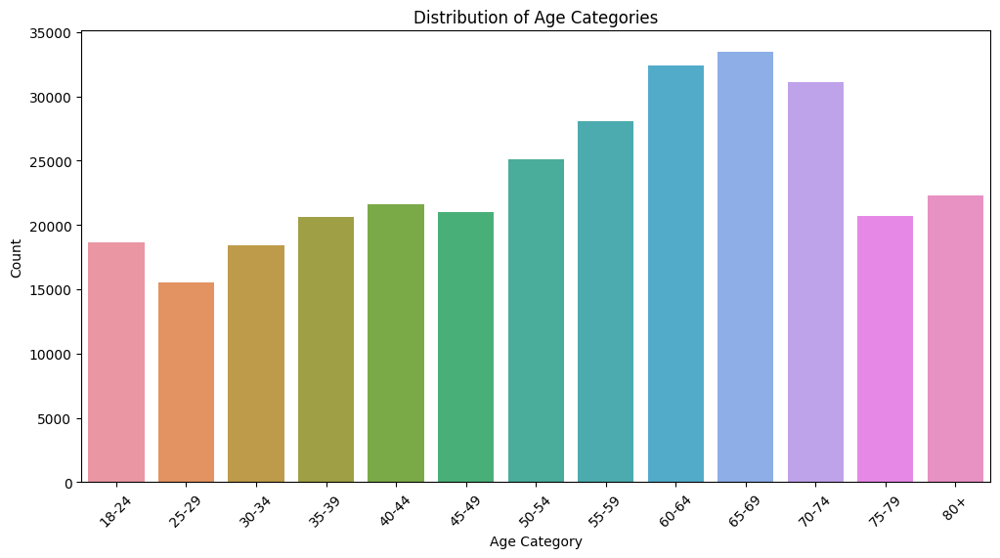

In [ ]:
age_category_order = [
    '18-24', '25-29', '30-34', '35-39', '40-44',
    '45-49', '50-54', '55-59', '60-64', '65-69',
    '70-74', '75-79', '80+'
]

# Create a count plot for the 'Age_Category' column
plt.figure(figsize=(12, 6))
sns.countplot(x='Age_Category', data=raw_data, order=age_category_order)
plt.title('Distribution of Age Categories')
plt.xlabel('Age Category')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

Age groups older than 50-54 and younger than 70-74 has the highest counts, with more than 20,000 counts each. The remaining age groups are around 20,000 counts each.

### 3.3 Examing Relationships Between Features


####3.3.1 General Health and Age

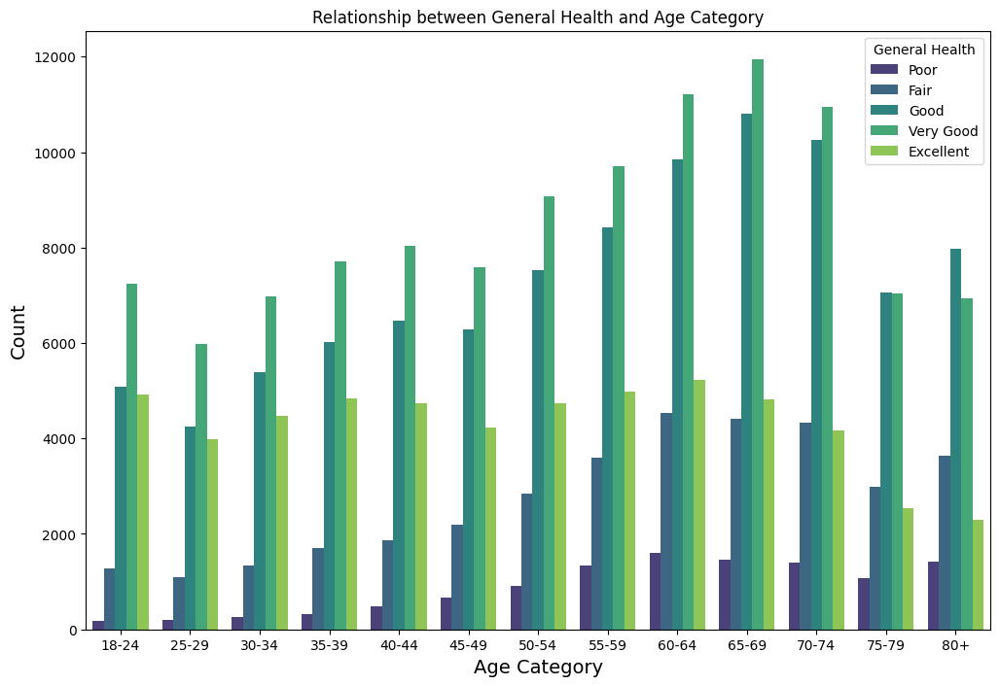

In [ ]:
# Define the desired order for the age and health categories
age_order = ['18-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '80+']
health_order = ['Poor', 'Fair', 'Good', 'Very Good', 'Excellent']  # Define health order with 'Poor' first

# Convert 'Age_Category' to a categorical type with the specified order
raw_data['Age_Category'] = pd.Categorical(raw_data['Age_Category'], categories=age_order, ordered=True)
raw_data['General_Health'] = pd.Categorical(raw_data['General_Health'], categories=health_order, ordered=True)

# Create the plot
plt.figure(figsize=(12, 8))
sns.countplot(x='Age_Category', hue='General_Health', data=raw_data, palette='viridis')
plt.title('Relationship between General Health and Age Category')
plt.xlabel('Age Category', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='General Health')
plt.show()

We've discovered two patterns in this graph.
- **Distribution Shift**:
There's a visible shift from a high frequency of 'Very Good' and 'Excellent' health statuses in younger age categories to more 'Poor' and 'Fair' statuses in the senior categories.

- **Health Status Balance**:
For most age categories, 'Good' health status tends to be reported frequently, which may indicate a moderate perception of health among the population.

Normalize the data

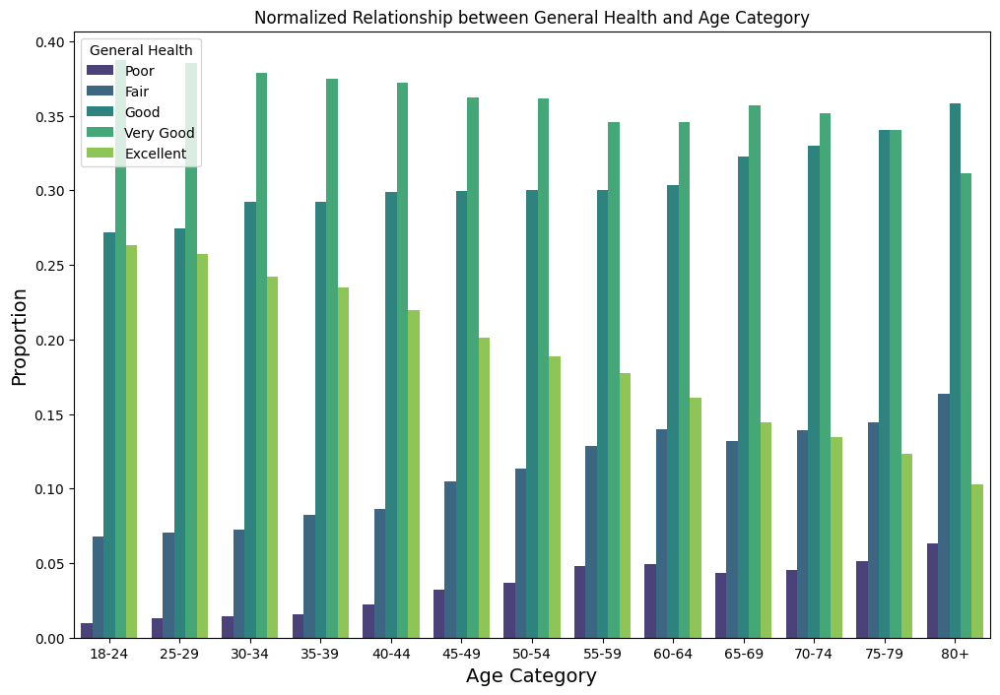

In [ ]:
# Define the desired order for the age and health categories
age_order = ['18-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '80+']
health_order = ['Poor', 'Fair', 'Good', 'Very Good', 'Excellent']  # Define health order with 'Poor' first

# Normalize the data
normalized_data = (raw_data.groupby('Age_Category')['General_Health']
                   .value_counts(normalize=True)
                   .rename('proportion')
                   .reset_index())

# Convert both 'Age_Category' and 'General_Health' to categorical types with the specified order
normalized_data['Age_Category'] = pd.Categorical(normalized_data['Age_Category'], categories=age_order, ordered=True)
normalized_data['General_Health'] = pd.Categorical(normalized_data['General_Health'], categories=health_order, ordered=True)

# Create the plot
plt.figure(figsize=(12, 8))
sns.barplot(x='Age_Category', y='proportion', hue='General_Health', data=normalized_data, palette='viridis')
plt.title('Normalized Relationship between General Health and Age Category')
plt.xlabel('Age Category', fontsize=14)
plt.ylabel('Proportion', fontsize=14)
plt.legend(title='General Health')
plt.show()

We have five main takeaways from this graph.

- **Decrease in Positive Health with Age**:
The proportion of individuals reporting 'Very Good' or 'Excellent' health appears to decrease with increasing age. This trend suggests a general decline in perceived health quality as people get older.

- **Increase in Negative Health Perceptions in Older Age Groups**:
Conversely, there is a noticeable increase in the proportion of 'Poor' and 'Fair' health reports among the older age demographics, particularly noticeable from the '70-74' age category and beyond.

- **Midlife Perception of Health**:
In the middle-age categories, from '35-39' to '60-64', there is a more balanced distribution of health perceptions, with 'Good' often being the most commonly reported health status.

- **Optimism in Youth**:
Younger age categories, such as '18-24' and '25-29', have a higher proportion of 'Very Good' and 'Excellent' health statuses compared to other age groups, indicating a more optimistic view of health among the younger population.

- **Stability in Middle Ages**:
The 'Good' health status remains relatively stable across the age groups as a common response, which may suggest that people in the middle age groups perceive their health as moderately good regardless of their actual age.

#### 3.3.2 Gerneral Health and BMI

BMI Distribution Across Health Categories

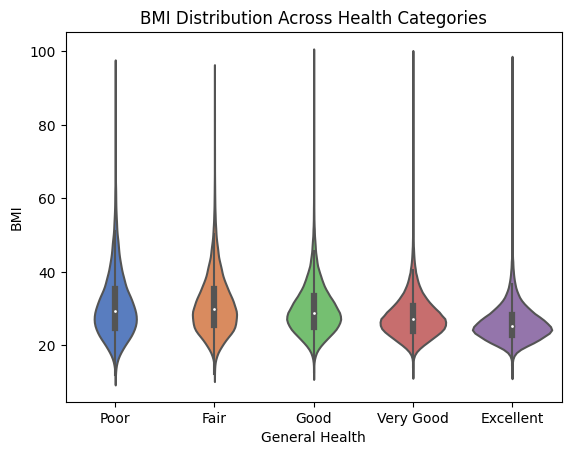

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt



temp = raw_data[['BMI', 'General_Health']]

# Create a violin plot
sns.violinplot(x='General_Health', y='BMI', data=temp, palette='muted')

plt.xlabel('General Health')
plt.ylabel('BMI')
plt.title('BMI Distribution Across Health Categories')

plt.show()


The distribution of BMI does not seem to drastically differ between the different health categories. However, the categories with 'Better' perceived health ('Very Good' and 'Excellent') appear to have a slightly narrower distribution, potentially indicating a concentration of healthier BMI values. The similarity in BMI distributions across health categories could suggest that people's perception of their health may not directly correlate with their BMI. People with higher BMIs may still report 'Very Good' or 'Excellent' health.

Age vs BMI

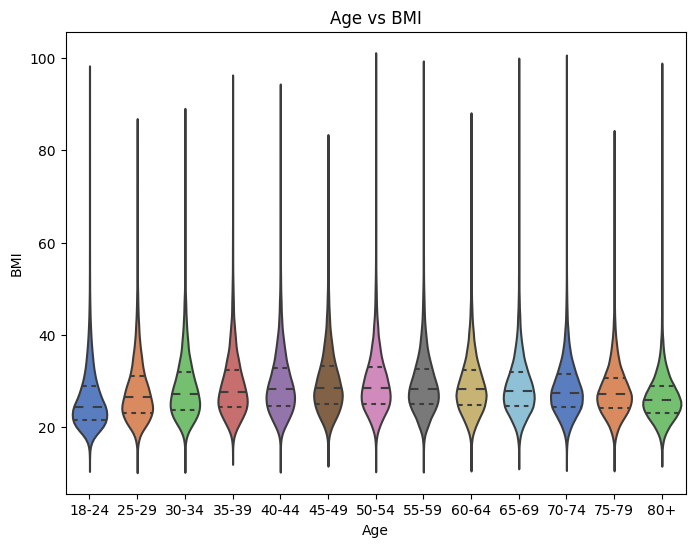

In [ ]:

age = raw_data['Age_Category']
BMI = raw_data['BMI']

plt.figure(figsize=(8,6))
# Create a scatter plot using Seaborn
sns.violinplot(x=age, y=BMI, palette='muted', inner='quartile')
# Add labels and title
plt.xlabel('Age')
plt.ylabel('BMI')
plt.title('Age vs BMI')

# Show the plot
plt.show()

Each age group shows a wide range of BMI values, indicated by the broad spread of the violin plots. This suggests that there is a significant variation in body types within each age group. There does not appear to be a significant trend in median BMI as age increases; however, the slight increase in the width of the violins in middle-aged groups could indicate a trend towards higher BMI in these age ranges.

#### 3.3.3 General Health and Consumption


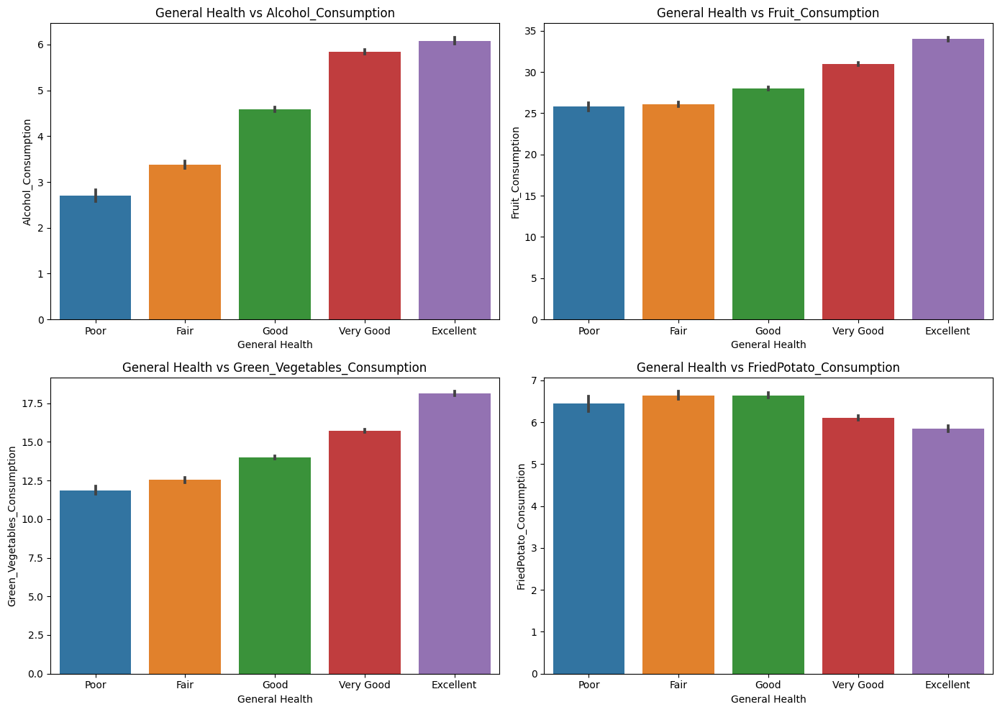

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the consumption variables
consumption_variables = [
    'Alcohol_Consumption', 'Fruit_Consumption',
    'Green_Vegetables_Consumption', 'FriedPotato_Consumption'
]

# Create a subplot for each consumption variable
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 10))
axes = axes.flatten()  # Flatten the array to iterate easily

for i, var in enumerate(consumption_variables):
    sns.barplot(x='General_Health', y=var, data=raw_data, ax=axes[i])
    axes[i].set_title(f'General Health vs {var}')
    axes[i].set_xlabel('General Health')
    axes[i].set_ylabel(var)

plt.tight_layout()
plt.show()

We have the following observations:

- **Alcohol Consumption**:
There's an increasing trend in alcohol consumption from 'Poor' to 'Excellent' health categories. This may suggest that those who perceive their health as better consume more alcohol on average, which is counterintuitive and could warrant further investigation to understand the underlying reasons.

- **Fruit Consumption**:
Fruit consumption also shows an increasing trend with better health perception. This is more in line with expectations, as a higher intake of fruit is commonly associated with better health outcomes.

- **Green Vegetables Consumption**:
Similar to fruit consumption, there's an increasing trend of green vegetables consumption with better self-reported health status. Individuals who rate their health as 'Excellent' consume the most green vegetables on average, which aligns with general dietary recommendations for health.

- **Fried Potato Consumption**:
The trend in fried potato consumption is less clear, with the 'Good' health category reporting the highest consumption. However, there does not appear to be a consistent increase or decrease in consumption associated with better or worse health perception.

####3.3.4 Examing Height and Weight

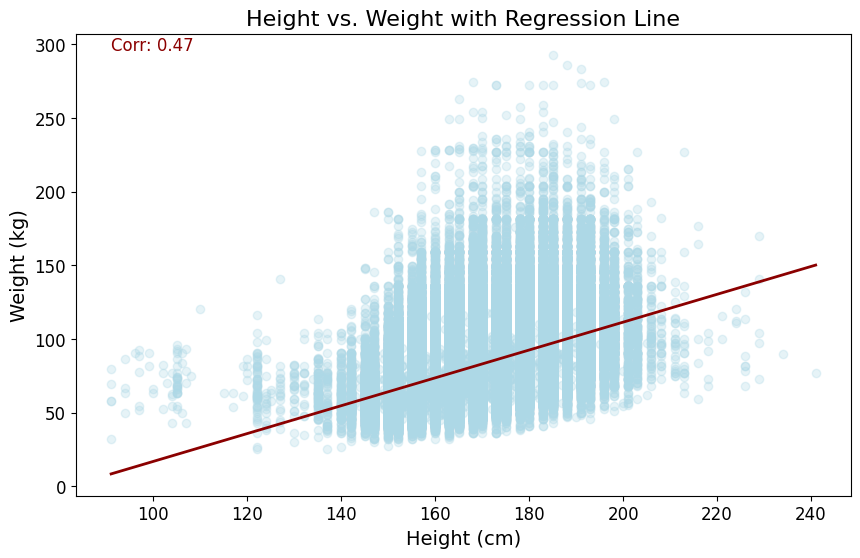

In [ ]:
# Scatter plot between Height and Weight
plt.figure(figsize=(10, 6))
sns.regplot(x='Height_(cm)', y='Weight_(kg)', data=raw_data,
            scatter_kws={'alpha':0.3, 'color': 'lightblue'},
            line_kws={'color': 'darkred', 'linewidth': 2})
plt.title('Height vs. Weight with Regression Line', fontsize=16)
plt.xlabel('Height (cm)', fontsize=14)
plt.ylabel('Weight (kg)', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

correlation = raw_data['Height_(cm)'].corr(raw_data['Weight_(kg)'])

# Annotate the plot with the correlation coefficient
plt.text(x=min(raw_data['Height_(cm)']), y=max(raw_data['Weight_(kg)']),
         s=f'Corr: {correlation:.2f}',
         color='darkred',
         fontsize=12,
         ha='left',
         va='bottom')

plt.show()

The graph suggests that there is a moderate positive correlation (0.47) between height and weight, which is consistent with common sense.

####3.3.5 Correlation matrix

In [ ]:
num_df = raw_data[['Height_(cm)','Weight_(kg)','BMI', 'Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']]

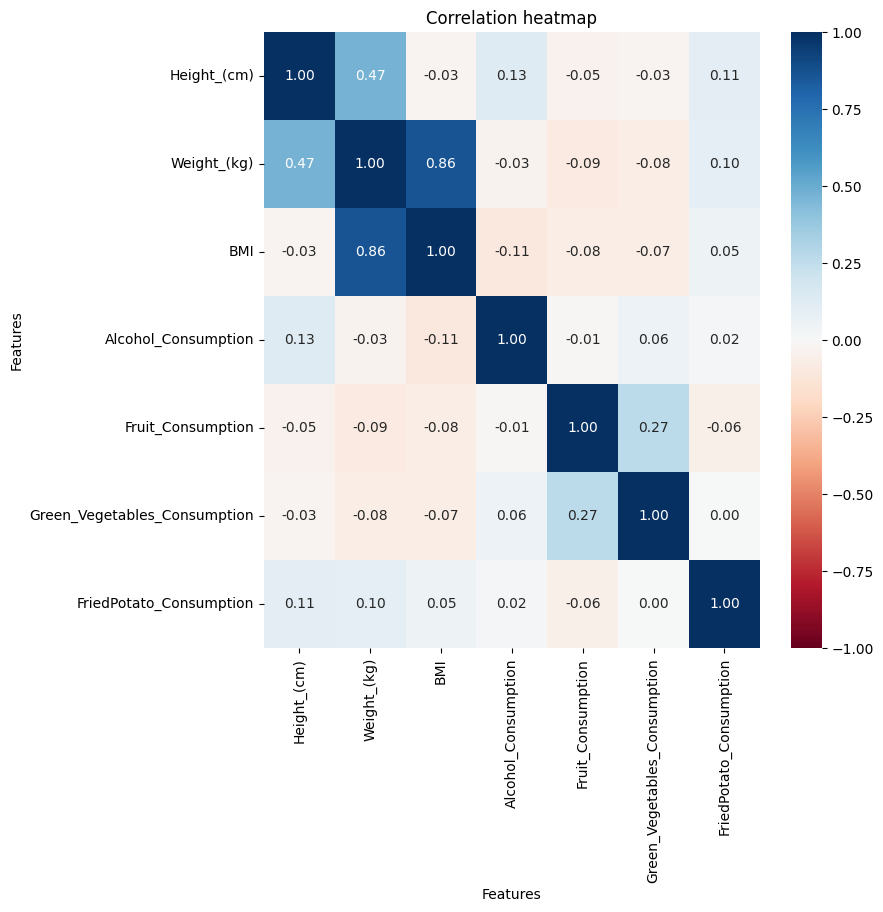

In [ ]:
corr_mat = num_df.corr()

plt.figure(figsize = (8,8))
sns.heatmap(corr_mat, cmap='RdBu', annot=True, fmt=".2f", vmin=-1, vmax=1)

plt.title('Correlation heatmap')
plt.xlabel('Features')
plt.ylabel('Features')

plt.show()

Generally, the pairwise correlation is insignificant, except for weight and BMI, so we decide to drop weight feature.

In [ ]:
df = raw_data.copy()
df = df.drop('Weight_(kg)', axis = 1)
df.dtypes

General_Health                  category
Checkup                           object
Exercise                          object
Heart_Disease                     object
Skin_Cancer                       object
Other_Cancer                      object
Depression                        object
Diabetes                          object
Arthritis                         object
Sex                               object
Age_Category                    category
Height_(cm)                      float64
BMI                              float64
Smoking_History                   object
Alcohol_Consumption              float64
Fruit_Consumption                float64
Green_Vegetables_Consumption     float64
FriedPotato_Consumption          float64
dtype: object

### 3.4 Feature Engineering

####3.4.1 Feature transformation

1. Covert "Checkup" into a numerial feature. Mapping checkup frequencies to numerical values. The larger the number, the more recent checkup.


*   The mapping reflects the recency and frequency of health checkups, indicating healthcare engagement. Higher values for more recent checkups enable the feature to serve as a useful indicator of health management and patient behavior in predictive analyses.



In [ ]:
# Mapping checkup frequencies to numerical values
checkup_mapping = {
    'Within the past year': 5,        # Most recent checkup
    'Within the past 2 years': 4,
    'Within the past 5 years': 3,
    '5 or more years ago': 2,         # Less recent checkup
    'Never': 1                        # No checkup
}

df['Checkup_Numerical'] = df['Checkup'].map(checkup_mapping)

2. Convert "Age_Category" into numerical values. We will use midpoint of each range to map each age range to a representative value.

*   By doing this, we effectively transformed the feature from categorical to numerical. This allows for more nuanced quantitative analysis and compatibility with machine learning algorithms. For the '80+' category, 85 is assumed as a representative age. This method simplifies age data while retaining the essence of each age group, enabling more effective data analysis and model training.




In [ ]:
def map_age_category_to_midpoint(age_category):
    age_mapping = {
        '18-24': 21, '25-29': 27, '30-34': 32, '35-39': 37,
        '40-44': 42, '45-49': 47, '50-54': 52, '55-59': 57,
        '60-64': 62, '65-69': 67, '70-74': 72, '75-79': 77,
        '80+': 85  # Assuming 85 as a representative age for '80+'
    }
    return age_mapping[age_category]

df['Age_Numerical'] = df['Age_Category'].apply(map_age_category_to_midpoint)
df['Age_Numerical'] = pd.to_numeric(df['Age_Numerical'], errors='coerce')

3. Combind values for "Diabetes".



*   **Combining 'No, pre-diabetes or borderline diabetes' with 'No':**\
  According to the CDC, pre-diabetes is a serious health condition where blood sugar levels are higher than normal, but not high enough to be diagnosed as type 2 diabetes. It is considered a warning sign or a 'pre-condition' rather than an actual diabetes diagnosis. Since pre-diabetes does not equate to having diabetes, we have combined 'No, pre-diabetes or borderline diabetes' with 'No' for clarity and consistency in our analysis.
For more information, refer to the CDC's overview of pre-diabetes:  (https://www.cdc.gov/diabetes/basics/prediabetes.html#:~:text=Prediabetes%20is%20a%20serious%20health,t%20know%20they%20have%20it.)
*    **Combining 'Yes, but female told only during pregnancy' with 'Yes':**\
Gestational diabetes is diagnosed during pregnancy and is classified as a type of diabetes, reflecting significant changes in glucose metabolism. The CDC acknowledges gestational diabetes as a variant of diabetes, given its implications and required management. Therefore, in line with clinical understanding and for uniformity in categorization, we have combined 'Yes, but female told only during pregnancy' with 'Yes'. Detailed information about gestational diabetes can be found here: (https://www.cdc.gov/diabetes/basics/gestational.html#:~:text=Gestational%20diabetes%20is%20a%20type,pregnancy%20and%20a%20healthy%20baby.)




In [ ]:
def recode_diabetes(value):
    if value == 'No' or value == 'No, pre-diabetes or borderline diabetes':
        return 'No'
    elif value == 'Yes' or value == 'Yes, but female told only during pregnancy':
        return 'Yes'
    else:
        return value  # Just in case there are other values not mentioned

df['Diabetes_Recode'] = df['Diabetes'].apply(recode_diabetes)

####3.4.2 New Features

1. BMI Categories: Categorize BMI into clinical groups for more nuanced analysis.

* According to CDC guidelines, a BMI below 18.5 is classified as 'Underweight,' 18.5 to less than 25 as 'Normal,' 25 to less than 30 as 'Overweight,' and 30 or above as 'Obese.' This method simplifies the continuous BMI data into categories that are clinically meaningful and widely recognized, enabling more effective data analysis and model training. (https://www.cdc.gov/healthyweight/assessing/bmi/adult_bmi/index.html)

In [ ]:
def categorize_bmi(bmi):
    if bmi < 18.5:
        return 'Underweight'
    elif bmi < 25:
        return 'Normal'
    elif bmi < 30:
        return 'Overweight'
    else:
        return 'Obese'
df['BMI_Category'] = df['BMI'].apply(categorize_bmi)

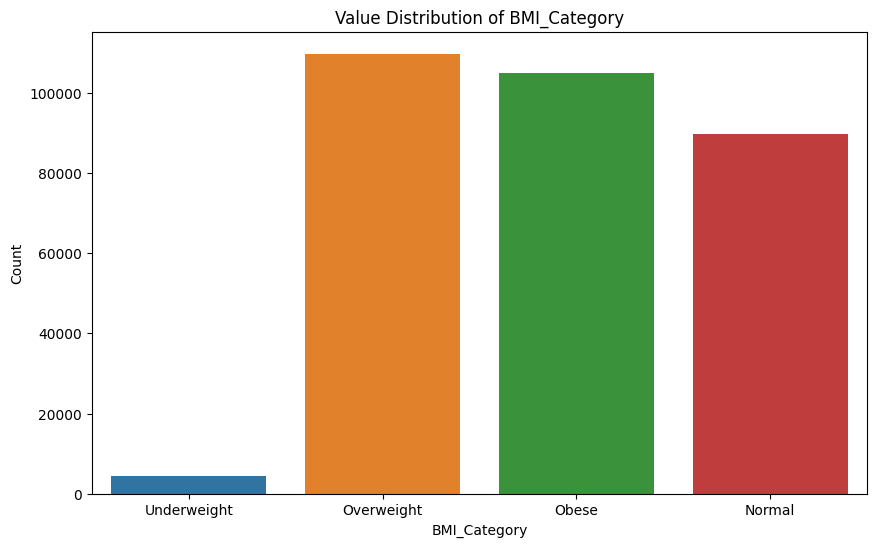

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='BMI_Category', data=df)
plt.title('Value Distribution of BMI_Category')
plt.xlabel('BMI_Category')
plt.ylabel('Count')
plt.show()

2. Age Groups: Group ages into broader categories like Young Adults, Middle-Aged Adults, and Seniors.

*   This simplification allows for more effective data analysis and model training by consolidating individual age ranges into broader, more manageable groups.



In [ ]:
def age_group(age_category):
    if age_category in ['18-24', '25-29', '30-34', '35-39']:
        return 'Young Adult'
    elif age_category in ['40-44', '45-49', '50-54', '55-59', '60-64']:
        return 'Middle-Aged Adult'
    else:
        return 'Senior'
df['Age_Group'] = df['Age_Category'].apply(age_group)

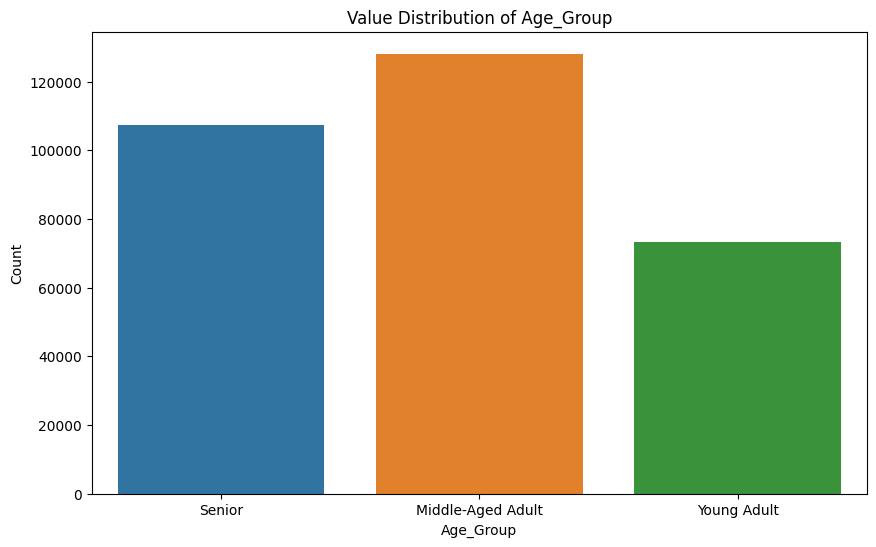

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Age_Group', data=df)
plt.title('Value Distribution of Age_Group')
plt.xlabel('Age_Group')
plt.ylabel('Count')
plt.show()

3. Dietary Quality Score: Assess overall diet quality based on fruit and vegetable consumption versus unhealthy choices.


*   This score is calculated to assess overall diet quality by considering both healthy and unhealthy food consumption patterns. We assume that higher fruit and vegetable intake correlates with healthier lifestyles, while frequent consumption of fried potatoes reflects less healthy choices. This metric enables us to estimate the relationship between health and dietary habits.



In [ ]:
df['Diet_Quality_Score'] = (df['Fruit_Consumption'] + df['Green_Vegetables_Consumption']) - df['FriedPotato_Consumption']

4. Cumulative Health Conditions and Health Risk Level: A count of the number of health conditions a person has could be a strong predictor for health risk.

* We calculate the total number of certain health conditions a person has, including skin cancer, other cancers, depression, diabetes, and arthritis. This cumulative count is then categorized into 'Health Risk Levels' to assess potential health risks. Individuals with no conditions are categorized as lowest risk (0), those with 1 to 2 conditions are considered medium risk (1), and those with 3 or more are categorized as high risk (2). This method provides a straightforward way to quantify health risk based on the number of concurrent health conditions, which is often a strong predictor of overall health status and future healthcare needs.

In [ ]:
def categorize_health_risk(cumulative_conditions):
    if cumulative_conditions == 0:
        return 0
    elif 1 <= cumulative_conditions <= 2:
        return 1
    else:  # 3 or more conditions
        return 2

health_conditions = ['Skin_Cancer', 'Other_Cancer', 'Depression', 'Diabetes_Recode', 'Arthritis']
df['Cumulative_Health_Conditions'] = df[health_conditions].apply(lambda x: x == 'Yes').sum(axis=1)
df['Health_Risk_Level'] = df['Cumulative_Health_Conditions'].apply(categorize_health_risk)

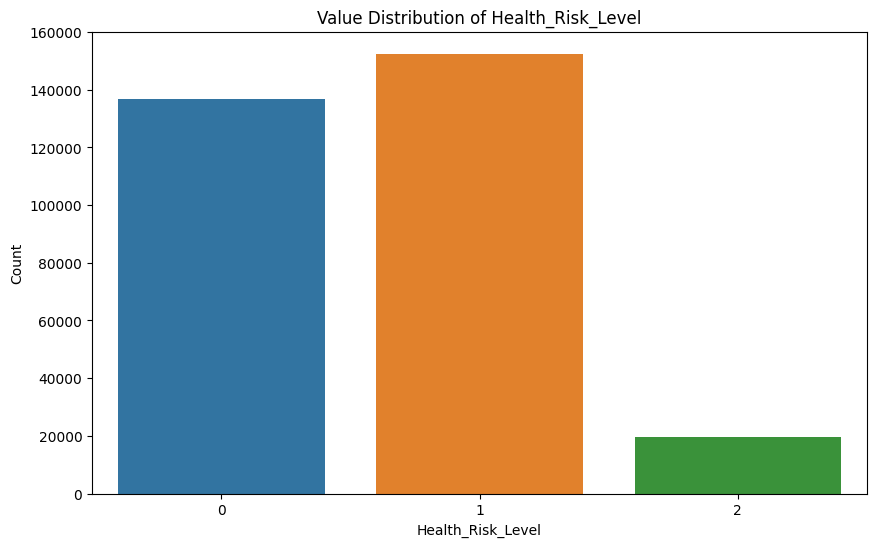

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Health_Risk_Level', data=df)
plt.title('Value Distribution of Health_Risk_Level')
plt.xlabel('Health_Risk_Level')
plt.ylabel('Count')
plt.show()

* We plan to use 'Health_Risk_Level' as the target variable in future machine learning models. However, the plot reveals an imbalanced distribution in this feature's values, which could potentially skew model performance. To address this, we may consider implementing resampling techniques in our modeling process. Resampling will help in balancing the dataset, ensuring that the models can learn effectively from all risk categories and provide more accurate and generalized predictions.

5. Health Awareness Index: The idea is to combine the recency of checkup with the number of health conditions to gauge health awareness.


*   We assume that more recent medical checkups indicate a higher level of health awareness. Therefore, the index is calculated by subtracting the number of health conditions. A higher index suggests more frequent checkups and fewer health conditions, implying greater health awareness. Conversely, a lower index indicates either fewer checkups, more health conditions, or both, suggesting lower health awareness. This metric aims to reflect how actively individuals engage with their health management.



In [ ]:
df['Health_Awareness_Index'] = df['Checkup_Numerical'] - df['Cumulative_Health_Conditions']

6. Metabolic Syndrome Risk: This feature is designed to assess the risk of metabolic syndrome, a cluster of conditions that significantly elevate the risk of heart disease, stroke, and type 2 diabetes.

* We focus on two major components associated with metabolic syndrome: high BMI and the presence of diabetes. Individuals with a BMI over 30 are considered to have one risk factor, and those with a diagnosis of diabetes represent another. The 'Metabolic Syndrome Risk' is calculated by summing these two factors, with a higher score indicating a greater risk. By assuming that high BMI and diabetes are proxies for metabolic syndrome risk, this feature aims to provide a simplified yet effective way to identify individuals at higher risk for these serious health conditions.
(https://www.hopkinsmedicine.org/health/conditions-and-diseases/metabolic-syndrome)

In [ ]:
df['Metabolic_Syndrome_Risk'] = (df['BMI'] > 30).astype(int) + (df['Diabetes'] == 'Yes').astype(int)

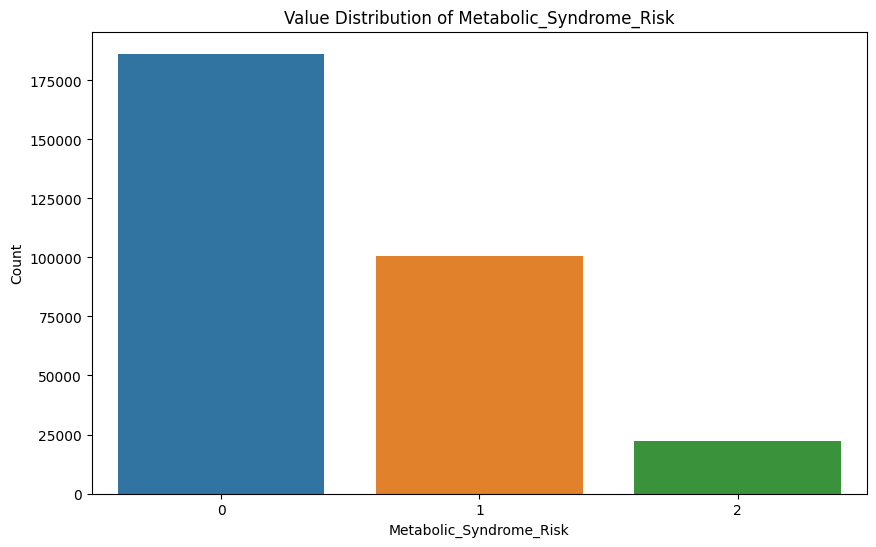

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Metabolic_Syndrome_Risk', data=df)
plt.title('Value Distribution of Metabolic_Syndrome_Risk')
plt.xlabel('Metabolic_Syndrome_Risk')
plt.ylabel('Count')
plt.show()

Now, let's check out the result of the feature engineering.

In [ ]:
df.dtypes

General_Health                  category
Checkup                           object
Exercise                          object
Heart_Disease                     object
Skin_Cancer                       object
Other_Cancer                      object
Depression                        object
Diabetes                          object
Arthritis                         object
Sex                               object
Age_Category                    category
Height_(cm)                      float64
BMI                              float64
Smoking_History                   object
Alcohol_Consumption              float64
Fruit_Consumption                float64
Green_Vegetables_Consumption     float64
FriedPotato_Consumption          float64
Checkup_Numerical                  int64
Age_Numerical                      int64
Diabetes_Recode                   object
BMI_Category                      object
Age_Group                         object
Diet_Quality_Score               float64
Cumulative_Healt

After completing our feature engineering process, we have decided to remove the 'Checkup', 'Age_Category', and 'Diabetes' columns from our dataset.


1. 'Checkup': The information from the 'Checkup' column is now represented in the 'Checkup_Numerical' column. We transformed the original categorical data into a numerical format that is more suitable for machine learning models.
2. 'Age_Category': Similar to 'Checkup', the 'Age_Category' column's categorical data has been transformed into a numerical format and is represented in the 'Age_Numerical' column. This numerical representation is more conducive to machine learning algorithms.
3. 'Diabetes': The 'Diabetes' column's information is captured in the 'Diabetes_Recode' column, where we have consolidated various diabetes-related responses into simpler categories.


In [ ]:
df = df.drop(['Checkup', 'Age_Category', 'Diabetes'], axis = 1)

In [ ]:
df.head()

,General_Health,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Height_(cm),BMI,...,Checkup_Numerical,Age_Numerical,Diabetes_Recode,BMI_Category,Age_Group,Diet_Quality_Score,Cumulative_Health_Conditions,Health_Risk_Level,Health_Awareness_Index,Metabolic_Syndrome_Risk
0,Poor,No,No,No,No,No,Yes,Female,150.0,14.54,...,4,72,No,Underweight,Senior,34.0,1,1,3,0
1,Very Good,No,Yes,No,No,No,No,Female,165.0,28.29,...,5,72,Yes,Overweight,Senior,26.0,1,1,4,1
2,Very Good,Yes,No,No,No,No,No,Female,163.0,33.47,...,5,62,Yes,Obese,Middle-Aged Adult,-1.0,1,1,4,2
3,Poor,Yes,Yes,No,No,No,No,Male,180.0,28.73,...,5,77,Yes,Overweight,Senior,52.0,1,1,4,1
4,Good,No,No,No,No,No,No,Male,191.0,24.37,...,5,85,No,Normal,Senior,12.0,0,0,5,0


### 3.5 One hot encoding

One-hot encoding transforms categorical variables into binary columns for each category, enhancing compatibility with machine learning models. This technique was applied to 'Age_Group', 'General_Health', and 'BMI_Category', and binary variables were created for 'Exercise', 'Heart Disease', and other health indicators, ensuring numerical representation for efficient model processing.

In [ ]:
df_edited = df.copy()
# One-hot encode for binary and categorical variables
df_edited['Exercise'] = df_edited['Exercise'].map({'Yes': 1, 'No': 0})
df_edited['Heart_Disease'] = df_edited['Heart_Disease'].map({'Yes': 1, 'No': 0})
df_edited['Skin_Cancer'] = df_edited['Skin_Cancer'].map({'Yes': 1, 'No': 0})
df_edited['Other_Cancer'] = df_edited['Other_Cancer'].map({'Yes': 1, 'No': 0})
df_edited['Depression'] = df_edited['Depression'].map({'Yes': 1, 'No': 0})
df_edited['Arthritis'] = df_edited['Arthritis'].map({'Yes': 1, 'No': 0})
df_edited['Smoking_History'] = df_edited['Smoking_History'].map({'Yes': 1, 'No': 0})
df_edited['Diabetes_Recode'] = df_edited['Diabetes_Recode'].map({'Yes': 1, 'No': 0})
# male = 1, female = 0
def convert_sex(x):
    if x == "Male":
        return 1
    return 0

df_edited['Sex'] = df_edited['Sex'].apply(convert_sex)
label_encoder = LabelEncoder()

df_edited = pd.get_dummies(df_edited, columns=['Age_Group'], prefix='Age_Group')
df_edited = pd.get_dummies(df_edited, columns=['General_Health'], prefix='General_Health')
df_edited = pd.get_dummies(df_edited, columns=['BMI_Category'], prefix='BMI_Category')
df_edited.head(10)

,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Height_(cm),BMI,Smoking_History,...,Age_Group_Young Adult,General_Health_Poor,General_Health_Fair,General_Health_Good,General_Health_Very Good,General_Health_Excellent,BMI_Category_Normal,BMI_Category_Obese,BMI_Category_Overweight,BMI_Category_Underweight
0,0,0,0,0,0,1,0,150.0,14.54,1,...,0,1,0,0,0,0,0,0,0,1
1,0,1,0,0,0,0,0,165.0,28.29,0,...,0,0,0,0,1,0,0,0,1,0
2,1,0,0,0,0,0,0,163.0,33.47,0,...,0,0,0,0,1,0,0,1,0,0
3,1,1,0,0,0,0,1,180.0,28.73,0,...,0,1,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,1,191.0,24.37,1,...,0,0,0,1,0,0,1,0,0,0
5,0,0,0,0,1,1,1,183.0,46.11,0,...,0,0,0,1,0,0,0,1,0,0
6,1,1,0,0,0,1,1,175.0,22.74,1,...,0,0,1,0,0,0,1,0,0,0
7,1,0,0,0,0,1,0,165.0,39.94,1,...,0,0,0,1,0,0,0,1,0,0
8,0,0,0,0,1,0,0,163.0,27.46,1,...,0,0,1,0,0,0,0,0,1,0
9,0,0,0,0,0,1,0,163.0,34.67,0,...,0,0,1,0,0,0,0,1,0,0


In [ ]:
df_edited.dtypes

Exercise                          int64
Heart_Disease                     int64
Skin_Cancer                       int64
Other_Cancer                      int64
Depression                        int64
Arthritis                         int64
Sex                               int64
Height_(cm)                     float64
BMI                             float64
Smoking_History                   int64
Alcohol_Consumption             float64
Fruit_Consumption               float64
Green_Vegetables_Consumption    float64
FriedPotato_Consumption         float64
Checkup_Numerical                 int64
Age_Numerical                     int64
Diabetes_Recode                   int64
Diet_Quality_Score              float64
Cumulative_Health_Conditions      int64
Health_Risk_Level                 int64
Health_Awareness_Index            int64
Metabolic_Syndrome_Risk           int64
Age_Group_Middle-Aged Adult       uint8
Age_Group_Senior                  uint8
Age_Group_Young Adult             uint8


Let's check the correlation matrix to decide which columns to drop to avoid multicollinearity.

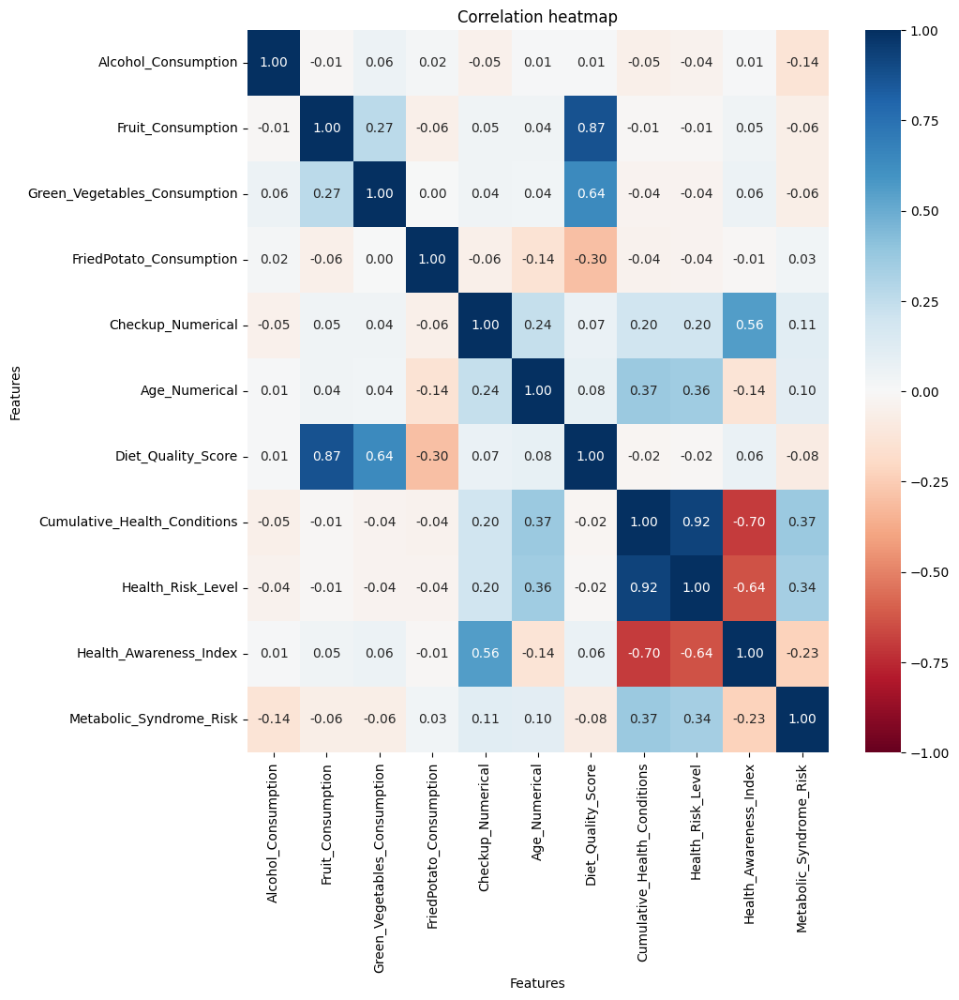

In [ ]:
df_selected = df_edited[['Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption', 'Checkup_Numerical', 'Age_Numerical', 'Diet_Quality_Score', 'Cumulative_Health_Conditions', 'Health_Risk_Level', 'Health_Awareness_Index', 'Metabolic_Syndrome_Risk']]

corr_mat = df_selected.corr()

plt.figure(figsize = (10,10))
sns.heatmap(corr_mat, cmap='RdBu', annot=True, fmt=".2f", vmin=-1, vmax=1)

plt.title('Correlation heatmap')
plt.xlabel('Features')
plt.ylabel('Features')

plt.show()

We decided to drop 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'Checkup_Numerical', and 'Cumulative_Health_Conditions' due to high collinearity (|correlation| > 0.5) observed in the correlation matrix, a measure indicating redundancy and potential distortion in model predictions. This step ensures more robust and reliable machine learning model performance.

In [ ]:
df_edited = df_edited.drop(['Fruit_Consumption', 'Green_Vegetables_Consumption', 'Checkup_Numerical', 'Cumulative_Health_Conditions'], axis = 1)

In [ ]:
df_edited.dtypes

Exercise                         int64
Heart_Disease                    int64
Skin_Cancer                      int64
Other_Cancer                     int64
Depression                       int64
Arthritis                        int64
Sex                              int64
Height_(cm)                    float64
BMI                            float64
Smoking_History                  int64
Alcohol_Consumption            float64
FriedPotato_Consumption        float64
Age_Numerical                    int64
Diabetes_Recode                  int64
Diet_Quality_Score             float64
Health_Risk_Level                int64
Health_Awareness_Index           int64
Metabolic_Syndrome_Risk          int64
Age_Group_Middle-Aged Adult      uint8
Age_Group_Senior                 uint8
Age_Group_Young Adult            uint8
General_Health_Poor              uint8
General_Health_Fair              uint8
General_Health_Good              uint8
General_Health_Very Good         uint8
General_Health_Excellent 

##Part 4: Modeling

#### 4.0 Preprocessing - Train Test Split

#####4.0.1 Heart Disease

We create the training and test dataset for health disease prediction. We used SMOTE to resample the training dataset because the distribution of health disease is extremely unbalanced, with bias towards people without health disease.

In [ ]:
df_hd = df_edited.copy()


In [ ]:
hd_y = df_hd['Heart_Disease']
hd_X = df_hd.drop('Heart_Disease', axis=1)

# Split the dataset into training and test sets
X_train_hd, X_test_hd, y_train_hd, y_test_hd = train_test_split(hd_X, hd_y, test_size=0.3, random_state=42)

In [ ]:
# Now use X_train_smote and y_train_smote to resample
smote = SMOTE()
X_train_hd_smote, y_train_hd_smote = smote.fit_resample(X_train_hd, y_train_hd)

#####4.0.2 Health Risk Level

We create the training and test dataset for health risk level prediction. We used SMOTE to resample the training dataset because the distribution of health risk level is unbalanced, with bias towards people with low health risks, and very few people with high-risk.

In [ ]:
df_hr = df_edited.copy()
df_hr = df_hr.drop(['Heart_Disease',	'Skin_Cancer',	'Other_Cancer',	'Depression',	'Arthritis', 'Health_Awareness_Index', 'Metabolic_Syndrome_Risk', 'Diabetes_Recode'], axis = 1)
df_hr.dtypes

Exercise                         int64
Sex                              int64
Height_(cm)                    float64
BMI                            float64
Smoking_History                  int64
Alcohol_Consumption            float64
FriedPotato_Consumption        float64
Age_Numerical                    int64
Diet_Quality_Score             float64
Health_Risk_Level                int64
Age_Group_Middle-Aged Adult      uint8
Age_Group_Senior                 uint8
Age_Group_Young Adult            uint8
General_Health_Poor              uint8
General_Health_Fair              uint8
General_Health_Good              uint8
General_Health_Very Good         uint8
General_Health_Excellent         uint8
BMI_Category_Normal              uint8
BMI_Category_Obese               uint8
BMI_Category_Overweight          uint8
BMI_Category_Underweight         uint8
dtype: object

In [ ]:
hr_y = df_hd['Health_Risk_Level']
hr_X = df_hd.drop('Health_Risk_Level', axis=1)

# Split the dataset into training and test sets
X_train_hr, X_test_hr, y_train_hr, y_test_hr = train_test_split(hr_X, hr_y, test_size=0.3, random_state=42)

In [ ]:
# Now use X_train_smote and y_train_smote to resample
smote = SMOTE()
X_train_hr_smote, y_train_hr_smote = smote.fit_resample(X_train_hr, y_train_hr)


### 4.1 K-Means

Firstly, we will use the Elbow Method to estimate the optimal number of clusters for K-Menas Clustering.

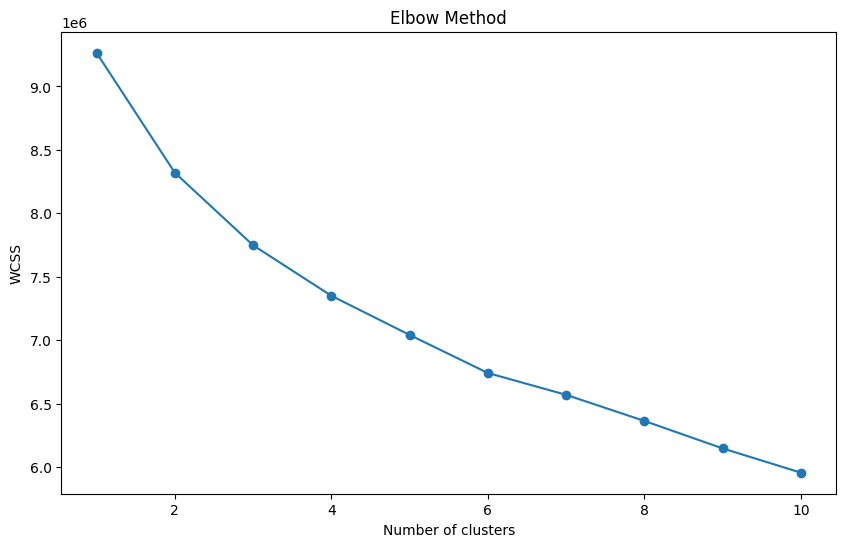

In [ ]:
# Preprocessing: Scale the data
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_edited)

# Calculate wcss for a range of k values
wcss = []
for i in range(1, 11):  # for example, testing 1 to 10 clusters
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(df_scaled)
    wcss.append(kmeans.inertia_)

# Plotting the results onto a line graph
plt.figure(figsize=(10,6))
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')  # Within cluster sum of squares
plt.show()

Based on this graph, we will choose 4 as the number of clusters, where the reduction in WCSS diminishes, suggesting the optimal number of clusters.

In [ ]:
# Choose the number of clusters
k = 4

# Apply K-means clustering
kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=0)
clusters = kmeans.fit_predict(df_scaled)

# Add the cluster labels to the original DataFrame
df['Cluster'] = clusters

In [ ]:
df.head()

,General_Health,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Height_(cm),BMI,...,Age_Numerical,Diabetes_Recode,BMI_Category,Age_Group,Diet_Quality_Score,Cumulative_Health_Conditions,Health_Risk_Level,Health_Awareness_Index,Metabolic_Syndrome_Risk,Cluster
0,Poor,No,No,No,No,No,Yes,Female,150.0,14.54,...,72,No,Underweight,Senior,34.0,1,1,3,0,1
1,Very Good,No,Yes,No,No,No,No,Female,165.0,28.29,...,72,Yes,Overweight,Senior,26.0,1,1,4,1,1
2,Very Good,Yes,No,No,No,No,No,Female,163.0,33.47,...,62,Yes,Obese,Middle-Aged Adult,-1.0,1,1,4,2,0
3,Poor,Yes,Yes,No,No,No,No,Male,180.0,28.73,...,77,Yes,Overweight,Senior,52.0,1,1,4,1,1
4,Good,No,No,No,No,No,No,Male,191.0,24.37,...,85,No,Normal,Senior,12.0,0,0,5,0,1


Check value distribution of the clusters. We can see that the distribution is even across the four clusters.

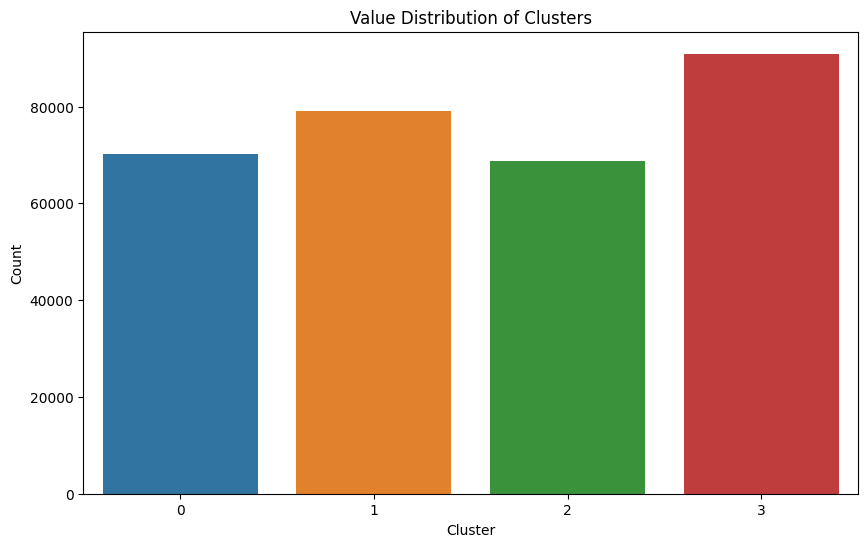

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Cluster', data=df)
plt.title('Value Distribution of Clusters')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

Check the 2-d distribution of the k-means after applying PCA for dimensionality reduction. We observe the clusters are well-separated in the reduced-dimensional space.

In [ ]:
# Apply PCA for 2D dimensionality reduction:
pca_2d = PCA(n_components=2)
df_pca_2d = pca_2d.fit_transform(df_scaled)


In [ ]:
# Access the loadings
loadings = pca_2d.components_

# Create a DataFrame for better visualization
loadings_df = pd.DataFrame(loadings, columns=df_edited.columns)

# Order the loadings by absolute values in descending order
sorted_loadings = loadings_df.apply(lambda x: x.abs()).sort_values(by=0, ascending=False, axis=1)

# Print the sorted loadings for the first principal component with column names
print("Sorted Loadings for the First Principal Component(top 5):")
print(sorted_loadings.iloc[0][:5])


Sorted Loadings for the First Principal Component(top 5):
Health_Risk_Level          0.367325
Metabolic_Syndrome_Risk    0.334176
Arthritis                  0.279041
Health_Awareness_Index     0.272979
Diabetes_Recode            0.263093
Name: 0, dtype: float64


In [ ]:
# Order the loadings by absolute values in descending order
sorted_loadings = loadings_df.apply(lambda x: x.abs()).sort_values(by=1, ascending=False, axis=1)

print("Sorted Loadings for the Second Principal Component(top 5):")
print(sorted_loadings.iloc[1][:5])


Sorted Loadings for the Second Principal Component(top 5):
BMI_Category_Obese         0.395522
BMI                        0.369408
Age_Group_Senior           0.356514
Age_Numerical              0.345264
Metabolic_Syndrome_Risk    0.328892
Name: 1, dtype: float64


In [ ]:
# Create a DataFrame for visualization:
df_vis_2d = pd.DataFrame(df_pca_2d, columns=['PC1', 'PC2'])
df_vis_2d['Cluster'] = clusters

# Plotting with Plotly for an interactive graph
fig_2d = px.scatter(df_vis_2d, x='PC1', y='PC2', color='Cluster',
                       title="K-means Clustering",
                       labels={'Cluster': 'K-means Cluster'})
fig_2d.show()

From component analysis above, important features captured in PC1 include Health_Risk_Level, Metabolic_Syndrome_Risk, Arthritis. These jointly serve to produce the group separations on this PC. Important features captured in PC2 include BMI_Category_Obese, BMI and Age_Group_Senior. These are important in generating grouping along this PC. We observe that these features are able to separate data into distinct clusters very well.

Check the 3-d distribution of the k-means

In [ ]:
# Apply PCA for 3D dimensionality reduction:
pca_3d = PCA(n_components=3)
df_pca_3d = pca_3d.fit_transform(df_scaled)

In [ ]:
# Create a DataFrame for visualization:
df_vis_3d = pd.DataFrame(df_pca_3d, columns=['PC1', 'PC2', 'PC3'])
df_vis_3d['Cluster'] = clusters

In [ ]:
# Plotting with Plotly for an interactive 3D graph
fig_3d = px.scatter_3d(df_vis_3d, x='PC1', y='PC2', z='PC3', color='Cluster',
                       title="K-means Clustering",
                       labels={'Cluster': 'K-means Cluster'})
fig_3d.show()

###4.2 PCA

####4.2.1 Heart Disease

We explore the relationship between the number of principal components and the cumulative explained variance. The knee plot helps determine the optimal number of components to retain based on a chosen explained variance threshold (in this case, 80%). Selecting the number of components to be 16 and 15 respectively for heart disease and health risk features that capture a sufficient amount of information while reducing the dimensionality of the data.

In [ ]:
# Intermediate step to address fact that PCA is not scale-invariant
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_hd_smote)
X_test_scaled = scaler.transform(X_test_hd)

# Instantiate and Fit PCA
pca = PCA()
X2 = pca.fit(X_train_scaled)

In [ ]:
# Save the explained variance ratios into variable called "explained_variance_ratios"
explained_variance_ratios = pca.explained_variance_ratio_

# Save the CUMULATIVE explained variance ratios into variable called "cum_evr"

## tutorial cumulative sum used: https://www.digitalocean.com/community/tutorials/numpy-cumsum-in-python
cum_evr = np.cumsum(explained_variance_ratios)

Text(0.5, 1.0, 'Cumulative Explained Variance vs. Number of PCA Components')

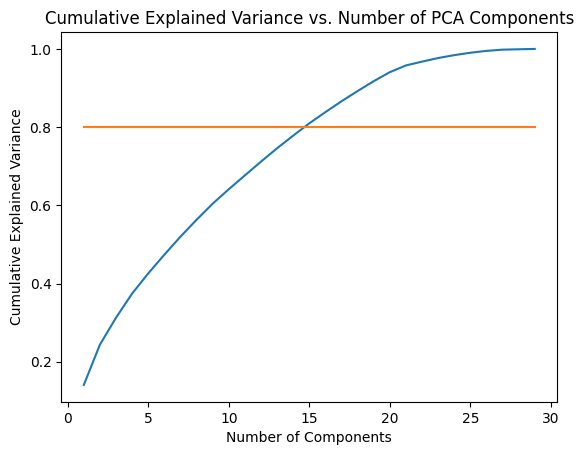

In [ ]:
# find optimal num components to use (n) by plotting explained variance ratio
x_ticks = np.arange(len(cum_evr)) + 1

plt.plot(size = [8, 6])
sns.lineplot(x = x_ticks, y = cum_evr)
sns.lineplot(x = x_ticks, y = 0.8 * np.ones(len(cum_evr)))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of PCA Components')

In [ ]:
# 1. Refit and transform on training with parameter n (as deduced from the last step)
n = 16
pca = PCA(n_components = n)
X_train_hd_pca = pca.fit_transform(X_train_scaled)

# 2. Transform on Testing Set and store it as `X_test_pca`
X_test_hd_pca = pca.transform(X_test_scaled)

####4.2.2 Health Risk Level

In [ ]:
# Intermediate step to address fact that PCA is not scale-invariant
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_hr_smote)
X_test_scaled = scaler.transform(X_test_hr)

# Instantiate and Fit PCA
pca = PCA()
X2 = pca.fit(X_train_scaled)

In [ ]:
# Save the explained variance ratios into variable called "explained_variance_ratios"
explained_variance_ratios = pca.explained_variance_ratio_

# Save the CUMULATIVE explained variance ratios into variable called "cum_evr"

## tutorial cumulative sum used: https://www.digitalocean.com/community/tutorials/numpy-cumsum-in-python
cum_evr = np.cumsum(explained_variance_ratios)

Text(0.5, 1.0, 'Cumulative Explained Variance vs. Number of PCA Components')

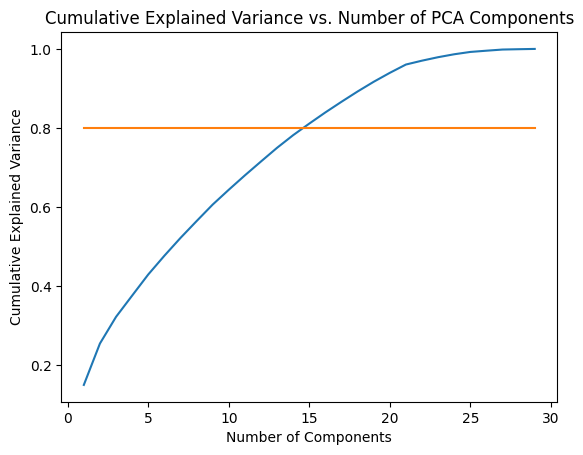

In [ ]:
# find optimal num components to use (n) by plotting explained variance ratio
x_ticks = np.arange(len(cum_evr)) + 1

plt.plot(size = [8, 6])
sns.lineplot(x = x_ticks, y = cum_evr)
sns.lineplot(x = x_ticks, y = 0.8 * np.ones(len(cum_evr)))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of PCA Components')

In [ ]:
# 1. Refit and transform on training with parameter n (as deduced from the last step)
n = 15
pca = PCA(n_components = n)
X_train_hr_pca = pca.fit_transform(X_train_scaled)

# 2. Transform on Testing Set and store it as `X_test_pca`
X_test_hr_pca = pca.transform(X_test_scaled)

### 4.3 Baseline Model: Simple Logistic Regression


We've chosen Logistic Regression as our baseline model for the following reasons:
- **Problem Type**: Logistic Regression is particularly suitable for classification problems.
- **Probabilistic Interpretation**: Logistic Regression not only predicts the category but also provides the probability of each outcome. This is crucial in healthcare settings where understanding the risk probability can aid in decision-making.
- **Interpretability**: One of the strengths of Logistic Regression is its interpretability. The model provides coefficients that can be directly interpreted in terms of odds ratios, allowing for an understanding of how each predictor influences the likelihood of having heart disease. This is valuable in medical research and practice, where explaining the impact of risk factors is as important as prediction accuracy.
- **Low Computational Cost**: Compared to more complex models like neural networks or ensemble methods, Logistic Regression is computationally less intensive. This makes it a good starting point, especially when dealing with large datasets.

#### 4.3.1 Heart_Disease


In [ ]:
# Initialize the Logistic Regression model
log_reg = LogisticRegression(max_iter=200, class_weight='balanced')

# Fit the model on the training data
log_reg.fit(X_train_hd_pca, y_train_hd_smote)

# Make predictions on the test set
y_pred = log_reg.predict(X_test_hd_pca)

# Evaluate the model
accuracy = accuracy_score(y_test_hd, y_pred)
auc_score = roc_auc_score(y_test_hd, y_pred)
print(f"Logistic Regression Accuracy: {accuracy}")

Logistic Regression Accuracy: 0.7511467023538426


0.75 is a relatively good accuracy rate for our baseline model, because for medical predictions, baselines can be much lower due to the complexity of the problem.

Then, we use the cross-validation to assess if we are overfitting.

In [ ]:
# Perform cross-validation
cv_scores = cross_val_score(log_reg, X_train_hd_pca, y_train_hd_smote, cv=5, scoring='accuracy')  # 5-fold cross-validation

# Calculate the mean and standard deviation of the scores
mean_cv_scores = cv_scores.mean()
std_cv_scores = cv_scores.std()
print(f"Mean CV Accuracy: {mean_cv_scores}")
print(f"Std CV Accuracy: {std_cv_scores}")

Mean CV Accuracy: 0.7820804009649207
Std CV Accuracy: 0.023707057381533402


The mean accuracy from cross-validation (0.78) is slightly higher than the accuracy we obtained previously (0.75). This is a positive indication, as it suggests that the model, on average, performs a bit better across different subsets of the training data compared to the initial test set. A higher cross-validation mean accuracy typically points towards a model that generalizes well. The standard deviation of the accuracy scores (0.02) across the folds is relatively low. This low standard deviation is desirable as it indicates consistency in the model's performance across different subsets of the data.

Now we plot the Roc curve to help us exam the predicting power of our model.

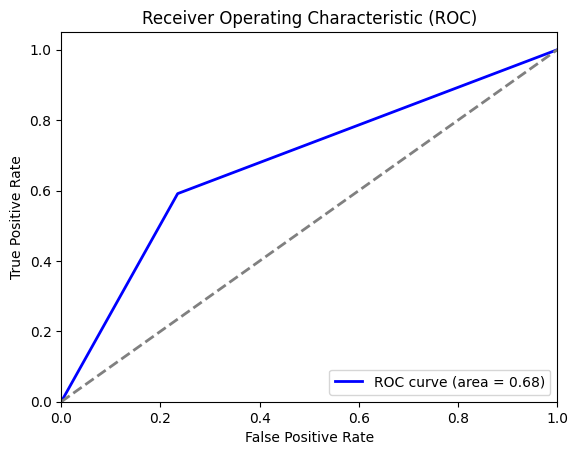

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test_hd, y_pred)
roc_auc = auc(fpr, tpr)

# Plotting the ROC curve
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

The area under the curve (AUC) is 0.68, which indicates a moderate ability to distinguish between the positive class (patients with heart disease) and the negative class (patients without heart disease). In other words, when it predicts a patient has heart disease, there's a 68% chance that the prediction is correct over random chance. It's better than random guessing, but there is still much room for improvement.

After that, we plot the confusion matrix to better assess our baseline model.

In [ ]:
# Generating a confusion matrix
cm = confusion_matrix(y_test_hd, y_pred)

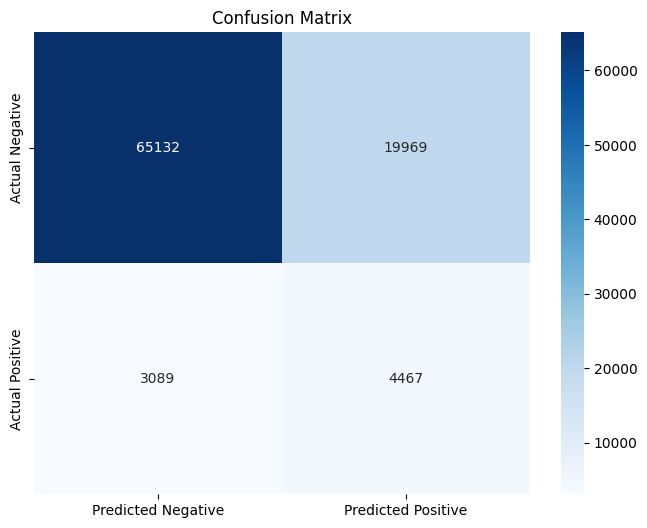

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.show()

To examine each component in the matrix:

- **True Negatives**: The model correctly identified over 65,000 instances where heart disease was not present. This is a significant number, indicating good model specificity.

- **False Positives**: There are slightly over 20,000 instances where the model incorrectly predicted heart disease when there was none. This is a relatively high number and could be problematic in a clinical setting because it could lead to unnecessary anxiety and further testing for those individuals.

- **False Negatives**: The model failed to identify aboutt 3,000 instances of actual heart disease. This type of error is particularly concerning in medical diagnostics because it represents missed diagnoses, which could result in no treatment for those patients.

- **True Positives**: The model correctly identified about 4,500 instances of heart disease. While this number is good, the relatively high number of False Negatives compared to True Positives suggests that the model may not be as sensitive as one would hope for a heart disease detection tool.

#### 4.3.2 Health Risk Level

In [ ]:
# Initialize the Logistic Regression model
log_reg = LogisticRegression(max_iter=200, class_weight='balanced', multi_class='ovr')

# Fit the model on the training data
log_reg.fit(X_train_hr_pca, y_train_hr_smote)

# Make predictions on the test set
y_pred = log_reg.predict(X_test_hr_pca)

# Evaluate the model
accuracy = accuracy_score(y_test_hr, y_pred)
# Ensure your logistic regression model predicts probabilities
y_pred_proba = log_reg.predict_proba(X_test_hr_pca)

# Calculate AUC using one-vs-rest ('ovr') or one-vs-one ('ovo') approach
auc_score = roc_auc_score(y_test_hr, y_pred_proba, multi_class='ovr')
print(f"Logistic Regression Accuracy: {accuracy}")
print(f"Logistic Regression AUC: {auc_score}")

Logistic Regression Accuracy: 0.8566649038928521
Logistic Regression AUC: 0.9461309585737835


- The accuracy (0.86) indicates that the model correctly predicted the health risk level (categorized into low, medium, or high) for 86% of the cases in the test set. This is quite impressive for a multiclass problem and suggests the model is robust in differentiating between the risk levels overall.

- With an AUC of 0.95, the model demonstrates an excellent capability to discriminate between the different 'Health Risk Levels'. This high value suggests that the model has a high true positive rate across the different thresholds while maintaining a low false positive rate.

Then, we use the cross-validation to assess if we are overfitting.

In [ ]:
# Perform cross-validation
cv_scores = cross_val_score(log_reg, X_train_hr_pca, y_train_hr_smote, cv=5, scoring='accuracy')  # 5-fold cross-validation

# Calculate the mean and standard deviation of the scores
mean_cv_scores = cv_scores.mean()
std_cv_scores = cv_scores.std()
print(f"Mean CV Accuracy: {mean_cv_scores}")
print(f"Std CV Accuracy: {std_cv_scores}")

Mean CV Accuracy: 0.8831849394076589
Std CV Accuracy: 0.0018648073745118714


- The mean accuracy (0.88) from the cross-validation is higher than the single hold-out test set accuracy (0.86). This is an excellent sign as it suggests that the model is performing consistently well across different folds of the data and is not overfitting to the particularities of the test set. It also indicates good generalizability of the model to new, unseen data.

- The standard deviation of the accuracy scores across the folds is very low, which implies that the variation in the model's performance across different folds is minimal. This suggests that the model is stable and not sensitive to the specific splits of the data, which is a good indicator of its robustness.

After that, we plot the confusion matrix to better assess our baseline model.

In [ ]:
# Generating a confusion matrix
cm = confusion_matrix(y_test_hr, y_pred)

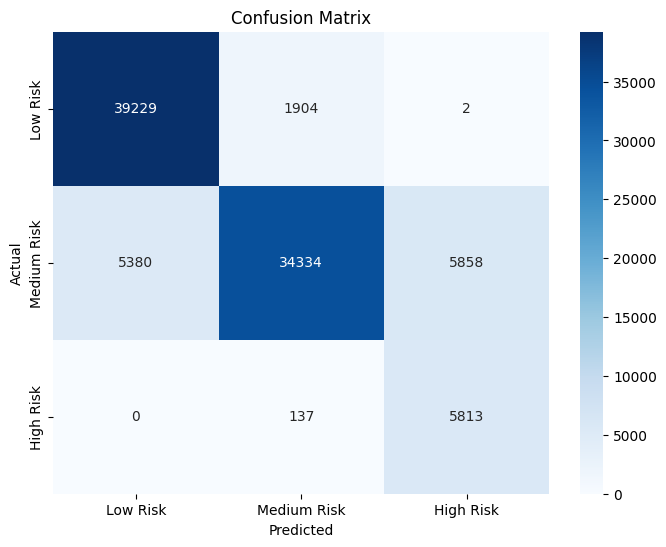

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Low Risk', 'Medium Risk', 'High Risk'], yticklabels=['Low Risk', 'Medium Risk', 'High Risk'])
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()

We see three implications from the matrix:
- **Good Performance on Extreme Classes**: The model is very effective at classifying the extreme risk levels (low and high), which is particularly important in a healthcare setting, as we want to be sure about the most at-risk individuals and those who are at low risk.

- **Challenges with Medium Risk**: There is a challenge with the medium-risk category, where a relatively balanced number of cases are being misclassified as either low or high risk. This suggests that the features that distinguish medium risk from the other categories are not as clear-cut or that the model might benefit from further tuning.

- **No High-Risk Underestimation**: Notably, the model does not underestimate high-risk cases as low risk, which is a positive outcome since failing to identify high-risk individuals could have more severe consequences than false alarms.

###4.4 Fine Tune the Baseline Model

We will fine tune out baseline model by changing the following parameters:
1. C: Inverse of regularization strength. Smaller values specify stronger regularization.
2. penalty: Type of regularization ('l1', 'l2', 'elasticnet', 'none').

#####4.4.1 Heart disease

In [ ]:
# Define the parameter grid
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10],
    'penalty': ['l1', 'l2'],
}

# Initialize the logistic regression model
log_reg = LogisticRegression()

# Initialize the Grid Search with cross-validation
grid_search = GridSearchCV(estimator=log_reg, param_grid=param_grid, cv=5, scoring='roc_auc')

# Fit the grid search to the data
grid_search.fit(X_train_hd_pca, y_train_hd_smote)

# Get the best parameters
print("Best parameters:", grid_search.best_params_)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning:


25 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 54, in _check_solver
    raise ValueError(
ValueError: Solv

Best parameters: {'C': 10, 'penalty': 'l2'}


Now, we use the best parameters from the grid search to retrain our model.

In [ ]:
best_params = grid_search.best_params_
model = LogisticRegression(**best_params)
model.fit(X_train_hd_pca, y_train_hd_smote)

LogisticRegression(C=10)

Evaluate the final model using following performance metrics: precision, recall, F1-score, ROC-AUC.

In [ ]:
# Making predictions on the test set
y_pred = model.predict(X_test_hd_pca)
y_pred_proba = model.predict_proba(X_test_hd_pca)[:, 1]

accuracy = accuracy_score(y_test_hd, y_pred)
print("Accuracy:", accuracy)

# Classification report
print("Classification Report:")
print(classification_report(y_test_hd, y_pred))

Accuracy: 0.7511467023538426
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.77      0.85     85101
           1       0.18      0.59      0.28      7556

    accuracy                           0.75     92657
   macro avg       0.57      0.68      0.56     92657
weighted avg       0.89      0.75      0.80     92657



We discover the following implications from the report:

- The model is very precise in predicting the majority class (no heart disease) but not as precise for the minority class (heart disease). This is a common issue in imbalanced datasets.
- The recall for the minority class is reasonably good, meaning the model has moderate sensitivity in detecting the positive cases.
- The low F1-score for the minority class suggests that the model struggles to find a good balance between precision and recall for the heart disease cases.
- The overall accuracy might not be the best metric to rely on due to the class imbalance.
- In a healthcare context, the low precision for the heart disease predictions may lead to a significant number of false positives, which could result in unnecessary stress and medical interventions for those patients.

ROC-AUC Score: 0.7591411202616163


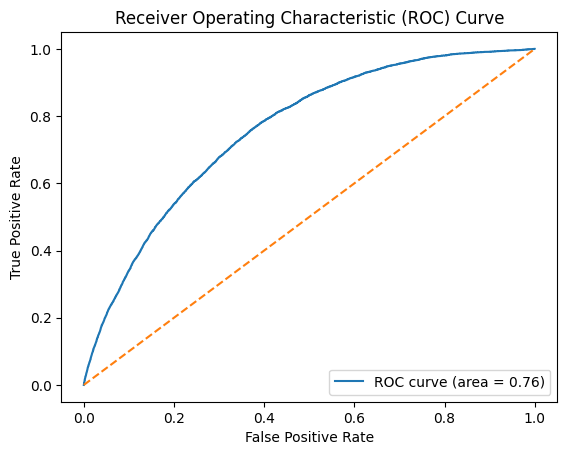

In [ ]:
# ROC-AUC Score
print("ROC-AUC Score:", roc_auc_score(y_test_hd, y_pred_proba))

# Plotting the ROC Curve
fpr, tpr, thresholds = roc_curve(y_test_hd, y_pred_proba)
plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc_score(y_test_hd, y_pred_proba):.2f})')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

The AUC score of 0.76 suggests that the model has a 76% chance of correctly distinguishing between a randomly chosen positive instance (actual heart disease) and a randomly chosen negative instance (no heart disease). The curve is above the diagonal line, which means the model performs better than random chance. However, the closer the curve follows the left-hand border and then the top border of the ROC space, the more accurate the test. Therefore, while the AUC of 0.76 is decent, there is room for improvement.  

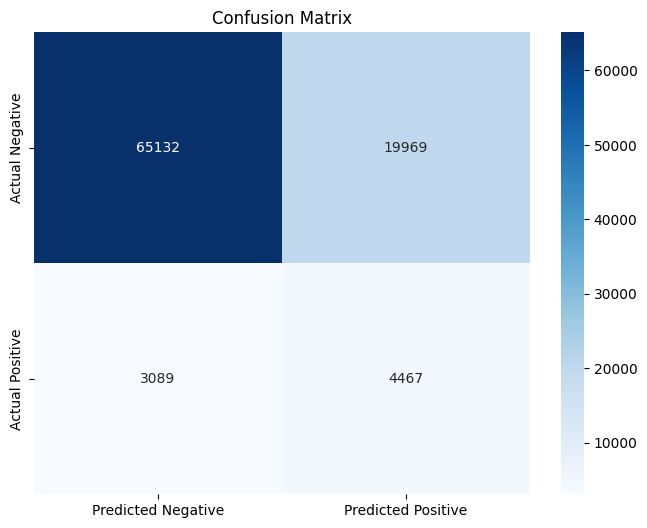

In [ ]:
# Confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_test_hd, y_pred), annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.show()

To examine each block in the matrix:

- **High True Negative Rate**: The model is very effective at identifying individuals without heart disease, which is the majority class. This is reflected in the high TN count.

- **High False Positive Rate**: There is a significant number of false positives, which can be concerning in a medical context as it might lead to unnecessary worry and further testing for those individuals. However, depending on the severity and treatability of the condition, this might be considered acceptable to ensure no cases of heart disease are missed.

- **Moderate False Negative Rate**: The FN rate is lower than the FP rate, which is preferable in disease prediction – it's more important to catch as many true cases as possible, even at the risk of some false alarms.

- **Moderate True Positive Rate**: While the number of TPs is not as high as it could be, the model does identify a reasonable number of actual heart disease cases.

#####4.4.2 Health Risk Level

In [ ]:
# Define the parameter grid
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10],
    'penalty': ['l1', 'l2']
}

# Initialize the logistic regression model
log_reg = LogisticRegression(max_iter=100)

# Initialize the Grid Search with cross-validation
# Use 'roc_auc_ovr' or 'accuracy' as the scoring method
grid_search = GridSearchCV(estimator=log_reg, param_grid=param_grid, cv=5, scoring='roc_auc_ovr')

# Fit the grid search to the data
grid_search.fit(X_train_hr_pca, y_train_hr_smote)

# Get the best parameters
print("Best parameters:", grid_search.best_params_)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning:


25 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 54, in _check_solver
    raise ValueError(
ValueError: Solv

Best parameters: {'C': 0.01, 'penalty': 'l2'}


Now, we use the best parameters from the grid search to retrain our model.

In [ ]:
best_params = grid_search.best_params_
model = LogisticRegression(**best_params)
model.fit(X_train_hr_pca, y_train_hr_smote)

LogisticRegression(C=0.01)

Evaluate the final model using following performance metrics: precision, recall, F1-score, ROC-AUC.

In [ ]:
# Making predictions on the test set
y_pred = model.predict(X_test_hr_pca)

# Get probabilities for all classes (not just one class)
y_pred_proba = model.predict_proba(X_test_hr_pca)

# Compute accuracy
accuracy = accuracy_score(y_test_hr, y_pred)
print("Accuracy:", accuracy)

# Classification report
print("Classification Report:")
print(classification_report(y_test_hr, y_pred))

Accuracy: 0.8982915483989337
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.93      0.93     41135
           1       0.93      0.86      0.89     45572
           2       0.62      0.98      0.76      5950

    accuracy                           0.90     92657
   macro avg       0.83      0.92      0.86     92657
weighted avg       0.91      0.90      0.90     92657



The implications we're discovered from the report are the following:

- The model performs well across all metrics, particularly for classes 0 and 1.
- While the recall for class 2 is excellent, the lower precision indicates that there are more false positives for the high-risk category. This might be acceptable in a healthcare setting where the cost of missing a high-risk individual is very high.
- There might be room to improve the precision for class 2, possibly by further tuning the model or by using different modeling techniques that could capture the nuances of high-risk cases better.

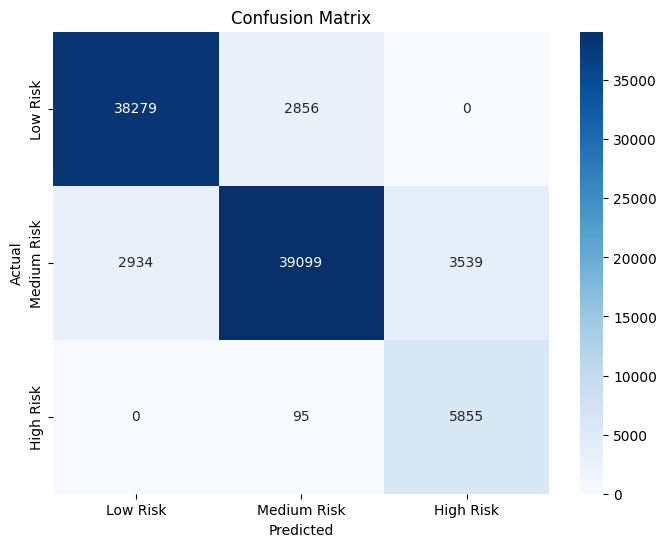

In [ ]:
# Draw confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_test_hr, y_pred), annot=True, fmt='d', cmap='Blues', xticklabels=['Low Risk', 'Medium Risk', 'High Risk'], yticklabels=['Low Risk', 'Medium Risk', 'High Risk'])
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()

The confusion matrix shows that:

- The model is highly accurate in predicting Low Risk cases, with a high number of true positives and relatively few false positives.

- For Medium Risk, the model also performs well, correctly identifying many true positives. However, there's a notable number of Low Risk cases misclassified as Medium Risk and a small number of High Risk cases misclassified as Medium Risk.

- High Risk predictions are very accurate with a significant number of true positives. The model does not mistakenly classify Low Risk cases as High Risk, which is critical for avoiding unnecessary interventions. The false negatives for High Risk (Medium Risk cases predicted as High Risk) are comparatively higher than the false positives, indicating a conservative approach that prioritizes not missing High Risk cases.

- There are no instances where High Risk is under-predicted as Low Risk, which is crucial for patient care as it ensures that high-risk patients are not overlooked.

### 4.5 Alternative Model: Random Forest

We chose Random Forest as our first alternative model for mainly four reasons:

- **Handling Non-Linear Relationships**: Random Forest is a non-parametric method, which means it does not assume any specific parametric form of the relationship between features and the target variable. This makes it particularly adept at capturing non-linear relationships that Logistic Regression might miss.

- **Feature Interactions**: Random Forest can naturally capture interactions between variables without the need to explicitly define them. In the context of heart disease, where interactions between risk factors can be complex and subtle, this property is highly beneficial.

- **Robustness to Overfitting**: Due to the ensemble nature of Random Forest, where it combines predictions from multiple decision trees, it tends to be more robust against overfitting compared to a single decision tree model, especially if there are enough trees and they are sufficiently diverse.

- **Parallelization**: Random Forests lend themselves well to parallelization (building trees in parallel), which can speed up the training process significantly, a useful feature for large datasets.

To make the process of fine tuning more efficient, we will use a subset (instead of the whole dataset) for fine-tuning given the following advantages:

- **Computational Efficiency**: Training on a full dataset, especially if it is large, can be computationally expensive and time-consuming. Using a smaller subset can significantly reduce training time, allowing for more rapid iteration and experimentation with different hyperparameters.

- **Overfitting Reduction**: Tuning hyperparameters on a smaller set can sometimes help mitigate overfitting. When a model is fine-tuned on the entire dataset, there is a risk that it will adapt too closely to the training data, learning noise and specific patterns that do not generalize well to unseen data.

- **Resource Allocation**: By using a subset of the data, resources can be allocated more effectively. The saved computational resources can then be used for validating the model on the full dataset or for other tasks such as feature engineering and model ensembling.

####4.5.1 Heart Disease


1. Create a Subset: Randomly select a portion of our training data.

In [ ]:
# Create a subset of the data (10% in this case)
X_train_subset, _, y_train_subset, _ = train_test_split(
    X_train_hd_pca, y_train_hd_smote, test_size=0.9, random_state=42)

2. Perform Hyperparameter Tuning on the Subset

In [ ]:
# Initialize the Random Forest model
rf_classifier_subset = RandomForestClassifier(random_state=42)

# Define the hyperparameter grid
param_grid = {
    'n_estimators': [25, 50, 100],
    'max_depth': [5, 7, 10]
}

# Initialize Grid Search with cross-validation on the subset
grid_search_subset = GridSearchCV(estimator=rf_classifier_subset, param_grid=param_grid,
                                  cv=3, verbose=2, n_jobs=-1)

# Fit the grid search to the subset of data
grid_search_subset.fit(X_train_subset, y_train_subset)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 7, 10],
                         'n_estimators': [25, 50, 100]},
             verbose=2)

In [ ]:
best_params_subset = grid_search_subset.best_params_
print("Best parameters on subset:", best_params_subset)

Best parameters on subset: {'max_depth': 10, 'n_estimators': 100}


3. Apply the Best Parameters to the Full Dataset.

In [ ]:
rf_classifier_optimized = RandomForestClassifier(**best_params_subset, random_state=42)
rf_classifier_optimized.fit(X_train_hd_pca, y_train_hd_smote)
y_pred = rf_classifier_optimized.predict(X_test_hd_pca)

In [ ]:
print("Random Forest Accuracy:", accuracy_score(y_test_hd, y_pred))
print("Classification Report:")
print(classification_report(y_test_hd, y_pred))

Random Forest Accuracy: 0.8550028600105767
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.90      0.92     85101
           1       0.25      0.40      0.31      7556

    accuracy                           0.86     92657
   macro avg       0.60      0.65      0.61     92657
weighted avg       0.89      0.86      0.87     92657



Several implications can be drew from the previous result:

- The model has an accuracy of approximately 85%. This means that overall, the model correctly predicts whether or not an individual has heart disease 85% of the time.

- The Random Forest model is quite good at identifying individuals without heart disease (class 0) but struggles with accurately predicting those with heart disease (class 1). This is a common issue in imbalanced datasets where the minority class (in this case, heart disease) is harder for the model to learn.

- The low precision for class 1 indicates a high number of false positives, where the model predicts heart disease in individuals who do not actually have it. This could lead to unnecessary medical interventions.

- The recall for class 1 is also not very high, meaning the model misses a fair number of true heart disease cases. This is particularly concerning in a medical context where failing to diagnose heart disease can have serious implications for the patient.

- Given the nature of the prediction task (medical diagnosis), the recall for class 1 might be considered more important than precision. It might be better for the model to overpredict heart disease than to miss cases.

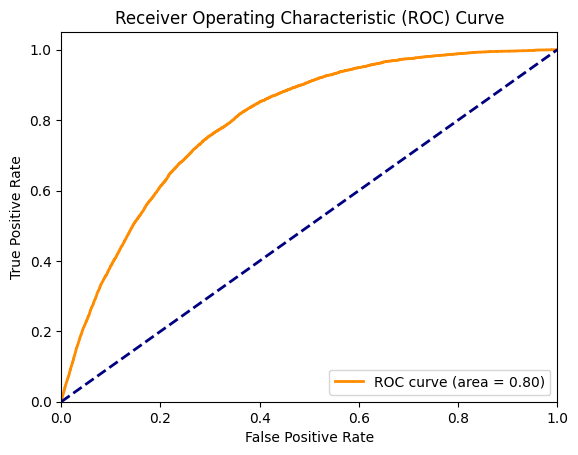

In [ ]:
# Predict probabilities for the positive class
y_pred_proba_rf = rf_classifier_optimized.predict_proba(X_test_hd_pca)[:, 1]

# Compute ROC curve and ROC area
fpr_rf, tpr_rf, _ = roc_curve(y_test_hd, y_pred_proba_rf)
roc_auc_rf = auc(fpr_rf, tpr_rf)

# Plotting the ROC Curve
plt.plot(fpr_rf, tpr_rf, color='darkorange',
         lw=2, label=f'ROC curve (area = {roc_auc_rf:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

The area under the ROC curve (AUC) is 0.80. This value quantifies the overall ability of the model to discriminate between the positive class (patients with heart disease) and the negative class (patients without heart disease).

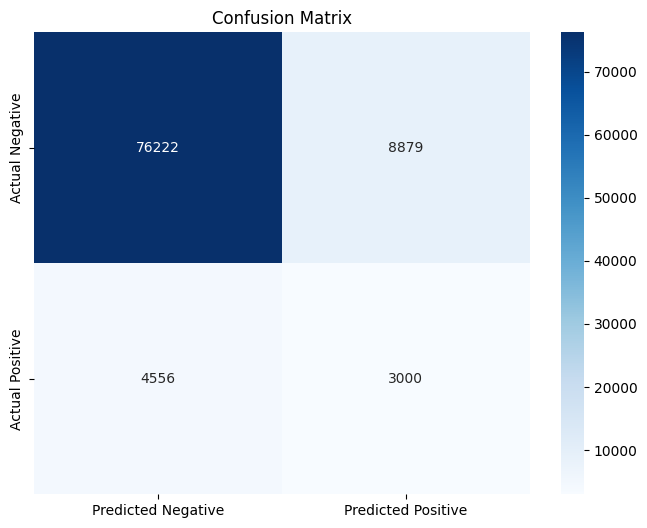

In [ ]:
# Confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_test_hd, y_pred), annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.show()

Four things stand out in the matrix:

- **Overall Predictive Power**: The model has a strong ability to identify individuals without heart disease, indicated by the high number of true negatives.

- **Concern with False Positives**: There is a considerable number of false positives, which in a clinical context could lead to unnecessary worry and further medical testing for those individuals. However, depending on the consequences of missing a true case of heart disease, some false positives might be acceptable.

- **False Negatives**: The number of false negatives, while lower than the false positives, is still significant. In the context of heart disease, these represent cases that the model failed to identify, which could potentially be serious if the condition goes untreated.

- **True Positives and Recall**: The model has correctly identified a number of true positive cases, but the recall (sensitivity) is not as high as it could be. This indicates that while the model is capturing some of the individuals with heart disease, there is room for improvement in detecting all cases.

####4.5.2 Health Risk Level

We will go through the same process to fine tune the Random Forest Model for Health Risk Level.

1. Create a Subset: Randomly select a portion of our training data.

In [ ]:
# Create a subset of the data (10% in this case)
X_train_subset, _, y_train_subset, _ = train_test_split(
    X_train_hr_pca, y_train_hr_smote, test_size=0.9, random_state=42)

2. Perform Hyperparameter Tuning on the Subset.

In [ ]:
# Initialize the Random Forest model
rf_classifier_subset = RandomForestClassifier(random_state=42)

# Define the hyperparameter grid
param_grid = {
    'n_estimators': [25, 50, 100],
    'max_depth': [5, 7, 10]
}

# Initialize Grid Search with cross-validation on the subset
grid_search_subset = GridSearchCV(estimator=rf_classifier_subset, param_grid=param_grid,
                                  cv=3, verbose=2, n_jobs=-1)

# Fit the grid search to the subset of data
grid_search_subset.fit(X_train_subset, y_train_subset)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 7, 10],
                         'n_estimators': [25, 50, 100]},
             verbose=2)

3. Find the best parameters.

In [ ]:
best_params_subset = grid_search_subset.best_params_
print("Best parameters on subset:", best_params_subset)

Best parameters on subset: {'max_depth': 10, 'n_estimators': 100}


4. Retrain the Model on the Full Dataset

In [ ]:
rf_classifier_optimized_hr = RandomForestClassifier(**best_params_subset, random_state=42)
rf_classifier_optimized_hr.fit(X_train_hr_pca, y_train_hr_smote)

RandomForestClassifier(max_depth=10, random_state=42)

5. Evaluate the Optimized Model

In [ ]:
y_pred = rf_classifier_optimized_hr.predict(X_test_hr_pca)

In [ ]:
# Evaluate the model
print("Random Forest Accuracy:", accuracy_score(y_test_hr, y_pred))
print("Classification Report:")
print(classification_report(y_test_hr, y_pred))
# print("Confusion Matrix:")
# print(confusion_matrix(y_test_hr, y_pred))

Random Forest Accuracy: 0.9239776811250094
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95     41135
           1       0.94      0.90      0.92     45572
           2       0.68      0.93      0.79      5950

    accuracy                           0.92     92657
   macro avg       0.86      0.93      0.89     92657
weighted avg       0.93      0.92      0.93     92657



The report conveys several important messages:

- The overall accuracy of the model is very high at over 92%, indicating that the model is correctly classifying the majority of the instances across all health risk levels.

- The model is exceptionally precise and consistent in identifying both low and medium risk individuals, as reflected in the high precision and recall scores for classes 0 and 1.

- Class 2 (High Risk) has a lower precision but a very high recall. This means the model is very good at identifying most of the high-risk cases but also has a relatively higher rate of false positives for this class. This could be acceptable in a health context, as it is generally preferable to over-identify risk (to ensure cases are not missed) rather than under-identify.

- The F1-scores are high for all classes, especially for low and medium risk, which suggests a good balance between precision and recall for these categories.

- The macro average scores indicate that the model performs well across all classes when not accounting for the class imbalance.

- The weighted average scores are also high, showing that when the class imbalance is accounted for, the model still performs very well.

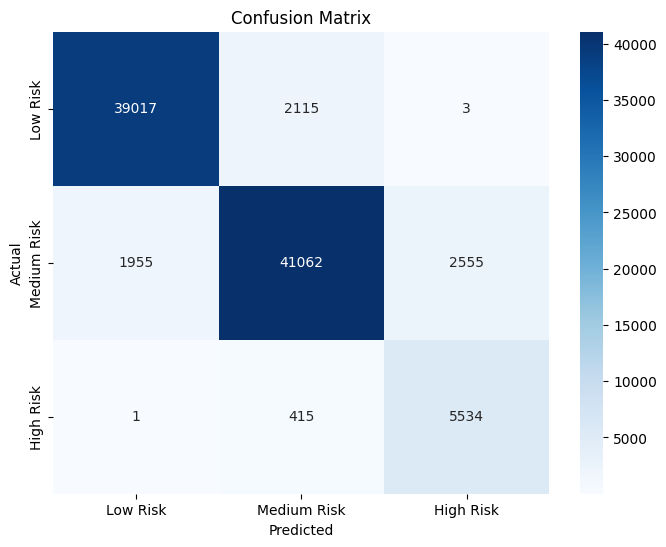

In [ ]:
# draw confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_test_hr, y_pred), annot=True, fmt='d', cmap='Blues', xticklabels=['Low Risk', 'Medium Risk', 'High Risk'], yticklabels=['Low Risk', 'Medium Risk', 'High Risk'])
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()

Key points to consider in this matrix:

- The model is most accurate in predicting low-risk cases.
- There is a notable amount of medium risk cases being classified as high risk, which could be problematic depending on the consequences of such a misclassification.
- The model is good at identifying high risk cases, which is often very important in risk models.
- The smallest number of misclassifications are in the actual low risk predicted as high risk, which is good as it indicates a low false alarm rate for the most severe class.

### 4.6 Alternative Model: Feedforward neural network

We decided to use Feedforward Neural Network as our second alternative model for the following considerations:

- **Non-Linearity in Data**: FNNs are capable of capturing complex, non-linear relationships in the data. If Logistic Regression, which assumes a linear boundary between classes, is not capturing the complexity of the data, an FNN might provide better performance due to its non-linearity.

- **Large Dataset**: FNNs can benefit from larger datasets, as more data can help in learning more intricate patterns without overfitting, compared to simpler models like Logistic Regression which might plateau in performance as data size increases.

- **Representation Learning**: Neural networks have the ability to learn representations of the data in the hidden layers. This means that they can transform the input data into more useful features that help in making better predictions, which Logistic Regression cannot do.

#### 4.6.1 Heart Disease

Set up the neural network model and prepare for fine tuning.

In [ ]:
# Define the neural network with a variable number of neurons in hidden layers
class BinaryClassifier(nn.Module):
    def __init__(self, neuron_size):
        super(BinaryClassifier, self).__init__()
        self.fc1 = nn.Linear(16, neuron_size)  # First hidden layer
        self.fc2 = nn.Linear(neuron_size, neuron_size)  # Second hidden layer
        self.fc3 = nn.Linear(neuron_size, 1)  # Output layer

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = torch.sigmoid(self.fc3(x))
        return x


neurons = [32, 64, 128]
learning_rates = [0.01, 0.001, 0.0001]


1. Create a Subset: Randomly select a portion of our training data.

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train_hd_pca, y_train_hd_smote, test_size=0.9, random_state=42)

2. Perform Hyperparameter Tuning on the subset and find the best hyperparameters.

In [ ]:
# Convert to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.float32)

# Dictionary to store the performance of each model
performance = {}

for neuron in neurons:
    for lr in learning_rates:
        # Initialize the model with the current number of neurons
        model = BinaryClassifier(neuron_size=neuron)

        # Define the loss function and optimizer
        criterion = nn.BCELoss()
        optimizer = optim.Adam(model.parameters(), lr=lr)

        # Store validation loss for this model configuration
        val_losses = []

        for epoch in range(10):  # Number of epochs
            # Training
            optimizer.zero_grad()
            outputs = model(X_train_tensor).squeeze()
            loss = criterion(outputs, y_train_tensor)
            loss.backward()
            optimizer.step()

            # Validation
            model.eval()  # Set the model to evaluation mode
            with torch.no_grad():
                val_outputs = model(X_val_tensor).squeeze()
                val_loss = criterion(val_outputs, y_val_tensor)
                val_losses.append(val_loss.item())
            model.train()  # Set the model back to training mode

        # Average validation loss for this configuration
        avg_val_loss = np.mean(val_losses)
        print(f"Neurons: {neuron}, Learning Rate: {lr}, Avg Validation Loss: {avg_val_loss}")

        # Storing the results
        performance[(neuron, lr)] = avg_val_loss

# Find the best performing model
best_params = min(performance, key=performance.get)
print(f"Best Parameters: Neurons - {best_params[0]}, Learning Rate - {best_params[1]}")

Neurons: 32, Learning Rate: 0.01, Avg Validation Loss: 0.5342693299055099
Neurons: 32, Learning Rate: 0.001, Avg Validation Loss: 0.6744864284992218
Neurons: 32, Learning Rate: 0.0001, Avg Validation Loss: 0.6913151919841767
Neurons: 64, Learning Rate: 0.01, Avg Validation Loss: 0.4979248583316803
Neurons: 64, Learning Rate: 0.001, Avg Validation Loss: 0.6733772575855255
Neurons: 64, Learning Rate: 0.0001, Avg Validation Loss: 0.6895486116409302
Neurons: 128, Learning Rate: 0.01, Avg Validation Loss: 0.4442156344652176
Neurons: 128, Learning Rate: 0.001, Avg Validation Loss: 0.6136669814586639
Neurons: 128, Learning Rate: 0.0001, Avg Validation Loss: 0.6804064393043519
Best Parameters: Neurons - 128, Learning Rate - 0.01


3. Retrain the model with the best parameters.

In [ ]:
model = Sequential([
    Dense(128, activation='relu', input_shape=(16,)),
    Dense(128, activation='relu'),
    Dense(1, activation='sigmoid')
])

In [ ]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.01), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train_hd_pca, y_train_hd_smote, epochs=10, batch_size=32, validation_split=0.1)

Epoch 1/10
11182/11182 [==============================] - 20s 2ms/step - loss: 0.2553 - accuracy: 0.8863 - val_loss: 0.1871 - val_accuracy: 0.9019
Epoch 2/10
11182/11182 [==============================] - 18s 2ms/step - loss: 0.2322 - accuracy: 0.9007 - val_loss: 0.1639 - val_accuracy: 0.9046
Epoch 3/10
11182/11182 [==============================] - 19s 2ms/step - loss: 0.2258 - accuracy: 0.9051 - val_loss: 0.1480 - val_accuracy: 0.9202
Epoch 4/10
11182/11182 [==============================] - 18s 2ms/step - loss: 0.2229 - accuracy: 0.9071 - val_loss: 0.1294 - val_accuracy: 0.9313
Epoch 5/10
11182/11182 [==============================] - 18s 2ms/step - loss: 0.2207 - accuracy: 0.9090 - val_loss: 0.1432 - val_accuracy: 0.9162
Epoch 6/10
11182/11182 [==============================] - 18s 2ms/step - loss: 0.2196 - accuracy: 0.9095 - val_loss: 0.1549 - val_accuracy: 0.9183
Epoch 7/10
11182/11182 [==============================] - 19s 2ms/step - loss: 0.2193 - accuracy: 0.9095 - val_loss: 0

4. Evaluate the optimized model.

In [ ]:
loss, accuracy = model.evaluate(X_test_hd_pca, y_test_hd)
print(f"Test Accuracy: {accuracy}")

2896/2896 [==============================] - 3s 1ms/step - loss: 0.2588 - accuracy: 0.9051
Test Accuracy: 0.9050584435462952


The accuracy of about 0.9 indicates great improvement, compared to the Logistic Regression (0.75) and Random Forest (0.85) model.

In [ ]:
# Making predictions on the test set
y_pred_nn = model.predict(X_test_hd_pca)
y_pred_nn_classes = (y_pred_nn > 0.5).astype("int32")


2896/2896 [==============================] - 3s 1ms/step


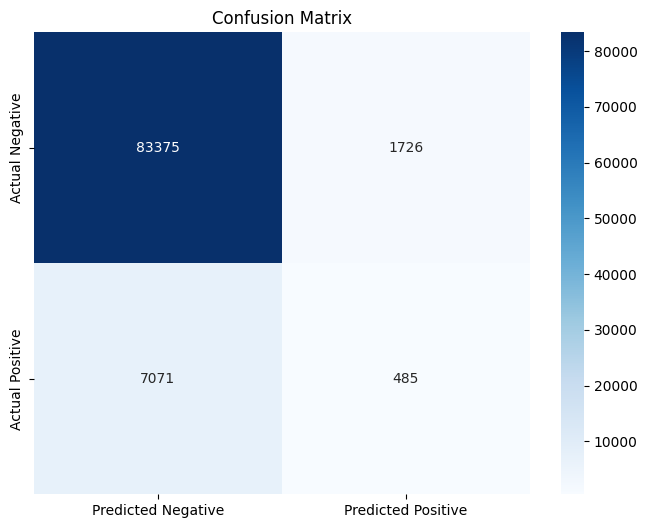

In [ ]:
# Compute confusion matrix
cm_nn = confusion_matrix(y_test_hd, y_pred_nn_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm_nn, annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.show()

We analyze the matrix in the following aspects:
- **High True Negative Rate**: The model is particularly good at identifying those who do not have heart disease, as indicated by the high number of true negatives.

- **Lower True Positive Rate**: The number of true positives is relatively low. This could be a concern because it implies that the model is not as effective at identifying all individuals who actually have heart disease.

- **False Negatives**: There are significantly more false negatives than true positives. In a medical context, this is potentially serious because it means the model is missing a substantial number of patients who do have heart disease. The consequences of a false negative in this context could be severe because it might mean a patient doesn't receive necessary treatment.-

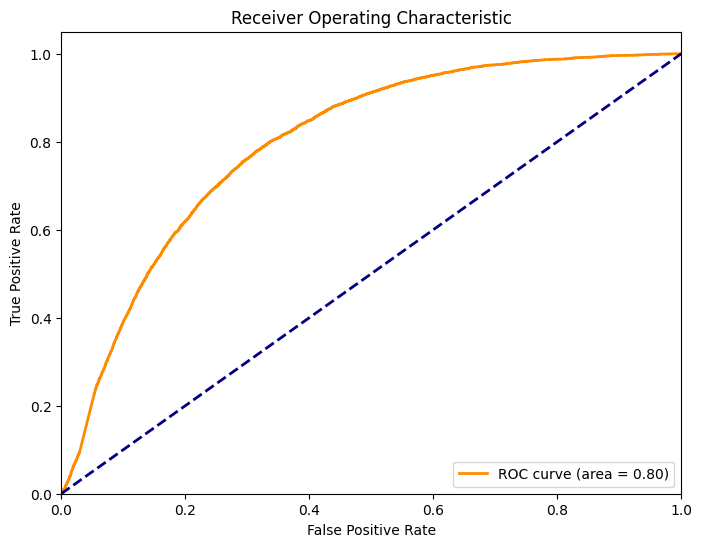

In [ ]:
# Compute ROC curve and AUC
fpr_nn, tpr_nn, _ = roc_curve(y_test_hd, y_pred_nn)
roc_auc_nn = auc(fpr_nn, tpr_nn)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_nn, tpr_nn, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc_nn:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

The ROC curve and a relatively high AUC value suggest that the neural network model has a good ability to distinguish between patients with and without heart disease

#### 4.6.2 Health Risk Level

1. Preprocess the data and build up the model.

In [ ]:
num_classes = 3

y_train_hr_encoded = to_categorical(y_train_hr_smote, num_classes)
y_test_hr_encoded = to_categorical(y_test_hr, num_classes)

class MultiClassClassifier(nn.Module):
    def __init__(self, input_size, neuron_size, num_classes):
        super(MultiClassClassifier, self).__init__()
        self.fc1 = nn.Linear(input_size, neuron_size)
        self.fc2 = nn.Linear(neuron_size, neuron_size)
        self.fc3 = nn.Linear(neuron_size, num_classes)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)  # No activation; nn.CrossEntropyLoss includes softmax
        return x

# Convert the data to PyTorch tensors
X_train_tensor = torch.tensor(X_train_hr_pca, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_hr_encoded, dtype=torch.float32)

# Hyperparameters
neurons = [32, 64, 128]
learning_rates = [0.01, 0.001, 0.0001]
num_epochs = 10
input_size = X_train_hr_pca.shape[1]
num_classes = 3

# Splitting the data for validation
X_train, X_val, y_train, y_val = train_test_split(X_train_hr_pca, y_train_hr_encoded, test_size=0.1, random_state=42)
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val, dtype=torch.float32)


2. Perform Hyperparameter Tuning on the subset and find the best hyperparameters.

In [ ]:
# Performance dictionary
performance = {}

for neuron in neurons:
    for lr in learning_rates:
        model = MultiClassClassifier(input_size, neuron, num_classes)
        criterion = nn.CrossEntropyLoss()
        optimizer = optim.Adam(model.parameters(), lr=lr)

        val_losses = []

        for epoch in range(num_epochs):
            model.train()
            optimizer.zero_grad()
            outputs = model(X_train_tensor)
            loss = criterion(outputs, y_train_tensor)
            loss.backward()
            optimizer.step()

            model.eval()
            with torch.no_grad():
                val_outputs = model(X_val_tensor)
                val_loss = criterion(val_outputs, y_val_tensor)
                val_losses.append(val_loss.item())

        avg_val_loss = np.mean(val_losses)
        print(f"Neurons: {neuron}, Learning Rate: {lr}, Avg Validation Loss: {avg_val_loss}")

        performance[(neuron, lr)] = avg_val_loss

best_params = min(performance, key=performance.get)
print(f"Best Parameters: Neurons - {best_params[0]}, Learning Rate - {best_params[1]}")

Neurons: 32, Learning Rate: 0.01, Avg Validation Loss: 0.7851500272750854
Neurons: 32, Learning Rate: 0.001, Avg Validation Loss: 1.0625317811965942
Neurons: 32, Learning Rate: 0.0001, Avg Validation Loss: 1.1165614128112793
Neurons: 64, Learning Rate: 0.01, Avg Validation Loss: 0.5849437296390534
Neurons: 64, Learning Rate: 0.001, Avg Validation Loss: 1.0294854760169982
Neurons: 64, Learning Rate: 0.0001, Avg Validation Loss: 1.085225486755371
Neurons: 128, Learning Rate: 0.01, Avg Validation Loss: 0.38588599413633345
Neurons: 128, Learning Rate: 0.001, Avg Validation Loss: 0.9393210053443909
Neurons: 128, Learning Rate: 0.0001, Avg Validation Loss: 1.0883975505828858
Best Parameters: Neurons - 128, Learning Rate - 0.01


In [ ]:
model_hr = Sequential([
    Dense(128, activation='relu', input_shape=(X_train_hr_pca.shape[1],)),
    Dense(128, activation='relu'),
    Dense(num_classes, activation='softmax')
])

In [ ]:
model_hr.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
model_hr.fit(X_train_hr_pca, y_train_hr_encoded, epochs=10, batch_size=32, validation_split=0.1)

Epoch 1/10
9022/9022 [==============================] - 15s 2ms/step - loss: 0.1060 - accuracy: 0.9607 - val_loss: 0.1462 - val_accuracy: 0.9415
Epoch 2/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0788 - accuracy: 0.9723 - val_loss: 0.1859 - val_accuracy: 0.9342
Epoch 3/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0737 - accuracy: 0.9744 - val_loss: 0.1707 - val_accuracy: 0.9222
Epoch 4/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0709 - accuracy: 0.9757 - val_loss: 0.1664 - val_accuracy: 0.9345
Epoch 5/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0683 - accuracy: 0.9763 - val_loss: 0.1069 - val_accuracy: 0.9508
Epoch 6/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0680 - accuracy: 0.9764 - val_loss: 0.0900 - val_accuracy: 0.9691
Epoch 7/10
9022/9022 [==============================] - 14s 2ms/step - loss: 0.0653 - accuracy: 0.9776 - val_loss: 0.0932 - val_ac

In [ ]:
loss, accuracy = model_hr.evaluate(X_test_hr_pca, y_test_hr_encoded)
print(f"Test Accuracy: {accuracy}")

2896/2896 [==============================] - 3s 1ms/step - loss: 0.0432 - accuracy: 0.9875
Test Accuracy: 0.9875346422195435


The accuracy of about 0.99 indicates great improvement, compared to the Logistic Regression (0.86) and Random Forest (0.93) model.

In [ ]:
# Making predictions on the test set
y_pred_nn = model_hr.predict(X_test_hr_pca)
y_pred_nn_classes = np.argmax(y_pred_nn, axis=1)

2896/2896 [==============================] - 3s 1ms/step


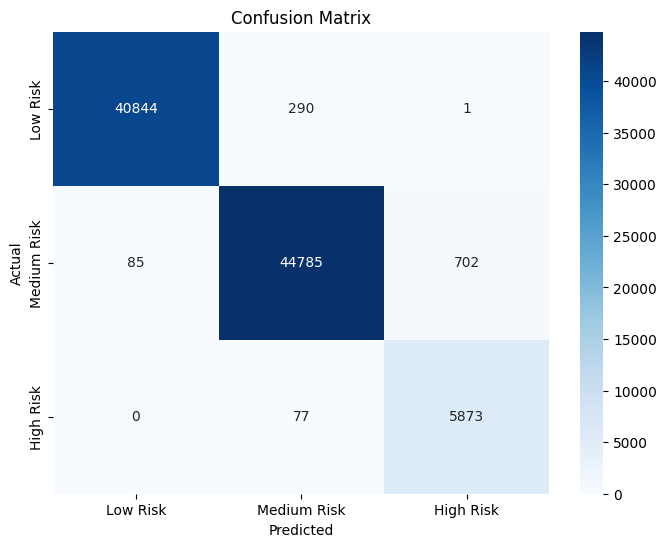

In [ ]:
# Compute confusion matrix
cm_nn = confusion_matrix(y_test_hr, y_pred_nn_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm_nn, annot=True, fmt='d', cmap='Blues', xticklabels=['Low Risk', 'Medium Risk', 'High Risk'], yticklabels=['Low Risk', 'Medium Risk', 'High Risk'])
plt.title('Confusion Matrix')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

Key points from the matrix:

- **Accuracy**: The model demonstrates high accuracy in predicting Low and High Risk cases, as seen from the high numbers of true positives and the low numbers of false positives and false negatives.

- **Sensitivity and Specificity**: The model seems to be very specific in its predictions, with Low Risk being almost perfectly identified. The sensitivity for High Risk detection is also high, considering the true positives and the low number of Medium Risk cases classified as High Risk.

- **Potential for Improvement**: While the model performs well for Low and High Risk predictions, there is some confusion between Medium and High Risk categories, as indicated by the 640 Medium Risk cases being misclassified as High Risk. This might be an area to focus on for model improvement, perhaps by looking at feature engineering or model tuning to better distinguish between these two classes.

## Part 5: Reflection

This reflection will delve into the challenges faced, the limitations acknowledged, and suggest avenues for potential future work.

**Challenges:**

- **Medical Knowledge Acquisition**: One of the significant hurdles was gaining a deeper understanding of the medical domain to effectively interpret the variables within the dataset. This involved online research to discern the relationship between disease-related variables and lifestyle factors. Medical knowledge also allowed us to create new medical indicators based on original variables in the dataset, which enhanced the predictive power of the models.

- **Data Imbalance**: The dataset presented a substantial challenge with its imbalance, where only a small fraction of observations corresponded to any one of the diseases. To address this, we implemented oversampling techniques, such as SMOTE, to artificially balance the dataset, thereby improving the models' ability to learn from minority classes.

**Limitations:**

- **Self-Reported Data**: The reliance on self-reported data from patient surveys introduces a degree of uncertainty. Self-reporting is often subject to bias and inaccuracy, as patients may not recall information correctly or may not have the medical literacy to report their conditions accurately.

- **Computational Constraints**: Hyperparameter tuning, an essential step in model optimization, was constrained by the limited computational resources available. This limitation meant that only a small subset of possible hyperparameter combinations could be explored, potentially leaving out more optimal model configurations.

**Potential Future Work:**

- **Expanding Data Sources**: To mitigate the limitations of self-reported data, future studies could integrate medical records or biometric data, where available, to validate and enrich the dataset.

- **Advanced Hyperparameter Optimization Techniques**: With more computational power, advanced techniques like Bayesian optimization, genetic algorithms, or automated machine learning (AutoML) frameworks could be employed to explore a broader hyperparameter space more efficiently.

- **Model Ensemble Techniques**: Combining predictions from various models could improve accuracy and robustness. Future work could explore ensemble methods, such as stacking or blending, especially integrating the output of the Feedforward Neural Network with models like Random Forest and Logistic Regression.

- **Deep Learning Exploration**: Given the success of the Feedforward Neural Network, further exploration into deep learning architectures such as Convolutional Neural Networks (CNNs) for structured data, or Long Short-Term Memory (LSTM) networks for sequential data, could be considered if the dataset characteristics support their application.

- **Model Interpretability**: With the increasing complexity of models, ensuring that they remain interpretable is vital, particularly in healthcare. Techniques such as SHAP (SHapley Additive exPlanations) or LIME (Local Interpretable Model-agnostic Explanations) could be incorporated to provide insights into model decisions.

- **Longitudinal Data Analysis**: If future datasets permit, analyzing patient data over time could provide insights into the progression of diseases and the long-term impact of lifestyle choices on health outcomes.